In [256]:
import pandas as pd       
import os 
import math 
import numpy as np
import matplotlib.pyplot as plt  
import IPython.display as ipd  # To play sound in the notebook
import librosa
import librosa.display
import os
from __future__ import print_function
import pathlib
import IPython.display as ipd  # To play sound in the notebook

import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import savgol_filter


from six.moves import xrange

import umap

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import torch.optim as optim

import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torchvision.utils import make_grid
from torchsummary import summary
import random
from torchviz import make_dot, make_dot_from_trace

In [257]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [285]:
torch.cuda.current_device()

0

In [287]:
torch.cuda.is_available()

True

In [258]:
# PATHS 

raw_data = '/home/ubuntu/voice_conversion/data/raw/VCTK-Corpus'
interim_data = os.path.join('/home/ubuntu/voice_conversion/data', 'interim')
spectogram_array_path =  os.path.join(interim_data, 'spectogram_array')
spectogram_array_path_trim_30db =  os.path.join(interim_data, 'spectogram_array_trim_30db')
spectrogram_path =os.path.join(interim_data, 'spectogram') 
audio_path = '/home/ubuntu/voice_conversion/data/raw/VCTK-Corpus/wav48/'
trim_audio_path = '/home/ubuntu/voice_conversion/data/trim_silence_30db'

In [235]:
# MKDIR
if not os.path.exists(interim_data):
    os.makedirs(interim_data)

if not os.path.exists(spectogram_array_path):
    os.mkdir(spectogram_array_path)

In [236]:
spectogram_array_path_trim_30db

'/home/ubuntu/voice_conversion/data/interim/spectogram_array_trim_30db'

## Load Data 

In [4]:
import os
import glob

files_np = list(glob.glob(os.path.join(spectogram_array_path_trim_30db,'*.*')))

In [14]:
len(files_np)

44242

In [5]:
col_shape = []
for file in files_np: 
    trial_x = np.load(file)
    _, cols = trial_x.shape
    col_shape.append(cols)

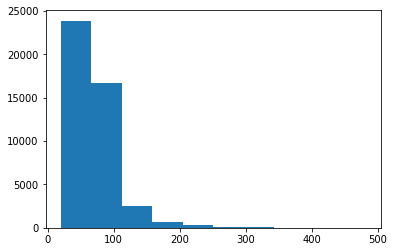

In [33]:
plt.hist(col_shape)

max_col = max(col_shape)

In [41]:
max_col=100
X_list = []
Y_list = []
for file in files_np:     
    load_x = np.load(file)
    x = np.zeros((load_x.shape[0], max_col), dtype = np.float32)
    c = min(max_col, load_x.shape[1])
    x[:load_x.shape[0], :c] = load_x[:, :c]
    
    x =torch.tensor(x, device='cpu').float()
    trial_y = file.split('trim_spec_p')[1][:3]
    trial_y =torch.tensor(int(trial_y), device='cpu').float()
    X_list.append(x)
    Y_list.append(trial_y)

In [42]:
Y_np_list = []
for file in files_np: 
    trial_y = file.split('trim_spec_p')[1][:3]
    Y_np_list.append(trial_y)


In [43]:
Y_np_list= list(set(Y_np_list))

In [44]:
speaker_dic = { Y_np_list[i]: i for i in range(0, len(Y_np_list) ) }

In [46]:
x_Tensor= torch.stack(X_list)

In [47]:
y_Tensor= torch.stack(Y_list)

In [48]:
full_tensordataset = torch.utils.data.TensorDataset(x_Tensor, y_Tensor)

In [51]:
full_loader = torch.utils.data.DataLoader(full_tensordataset, batch_size= 10 ,pin_memory= True, shuffle= True  )

In [58]:
train_val_size = int(0.9 * len(full_tensordataset))
test_size = len(full_tensordataset)- train_val_size
train__val_dataset, test_dataset = torch.utils.data.random_split(full_tensordataset, [train_val_size, test_size])
train_size = int(0.9 * len(train__val_dataset))
val_size = len(train__val_dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(train__val_dataset, [train_size, val_size])

In [259]:
len(train__val_dataset)

39817

In [63]:
len(test_dataset)+len(train_dataset)+len(val_dataset)

44242

## Vector Quantizer Layer

This layer takes a tensor to be quantized. The channel dimension will be used as the space in which to quantize. All other dimensions will be flattened and will be seen as different examples to quantize.

The output tensor will have the same shape as the input.

As an example for a `BCHW` tensor of shape `[16, 64, 32, 32]`, we will first convert it to an `BHWC` tensor of shape `[16, 32, 32, 64]` and then reshape it into `[16384, 64]` and all `16384` vectors of size `64`  will be quantized independently. In otherwords, the channels are used as the space in which to quantize. All other dimensions will be flattened and be seen as different examples to quantize, `16384` in this case.

In [260]:
batch_size = 10
num_training_updates = 15000

# Encoder
num_hiddens = 768
num_residual_hiddens = 32
num_residual_layers = 2
# input_dim: 256

# VQ
# This value is not that important, usually 64 works.
# This will not change the capacity in the information-bottleneck.
embedding_dim = 64
# The higher this value, the higher the capacity in the information bottleneck.
num_embeddings = 300

# Commitment cost should be set appropriately. It's often useful to try a couple
# of values. It mostly depends on the scale of the reconstruction cost
# (log p(x|z)). So if the reconstruction cost is 100x higher, the
# commitment_cost should also be multiplied with the same amount.
# 0.25 as specified in the paper.
commitment_cost = 0.25

# Only uses for the EMA updates (instead of the Adam optimizer).
# This typically converges faster, and makes the model less dependent on choice
# of the optimizer. In the original VQ-VAE paper [van den Oord et al., 2017],
# EMA updates were not used (but suggested in appendix) and compared in
# [Roy et al., 2018].
decay = -0.99

learning_rate = 1e-4

In [261]:
class VectorQuantizer(nn.Module):
    def __init__(self, num_embeddings, embedding_dim, commitment_cost, device):
        super(VectorQuantizer, self).__init__()
        
        self._embedding_dim = embedding_dim
        self._num_embeddings = num_embeddings
        
        self._embedding = nn.Embedding(self._num_embeddings, self._embedding_dim)
        self._embedding.weight.data.uniform_(-1/self._num_embeddings, 1/self._num_embeddings)
        self._commitment_cost = commitment_cost
        self._device = device

    def forward(self, inputs):
        #print('shape of inputs in VectorQuantizer.forward',inputs.size())
        # convert inputs from BCHW (here its B, F, T) -> BHWC
        inputs = inputs.permute(0, 2, 1).contiguous()
        input_shape = inputs.shape
        #print('shape of permutated inputs in VectorQuantizer.forward',input_shape)
        
        
        _, time, batch_size = input_shape
        
        # Flatten input
        flat_input = inputs.view(-1, self._embedding_dim)
        #print('shape of flat_input in VectorQuantizer.forward',flat_input.size())
        #print('device of flat_input',flat_input.device)
        
        # Calculate distances
        distances = (torch.sum(flat_input**2, dim=1, keepdim=True) 
                    + torch.sum(self._embedding.weight**2, dim=1)
                    - 2 * torch.matmul(flat_input, self._embedding.weight.t()))
            
        # Encoding
        encoding_indices = torch.argmin(distances, dim=1).unsqueeze(1)
        encodings = torch.zeros(encoding_indices.shape[0], self._num_embeddings, device=inputs.device)
        encodings.scatter_(1, encoding_indices, 1)
        
        # Quantize and unflatten
        quantized = torch.matmul(encodings, self._embedding.weight).view(input_shape)
        #print('shape of quantized in VectorQuantizer.forward',quantized.size())
        
        # Loss
        e_latent_loss = F.mse_loss(quantized.detach(), inputs)
        q_latent_loss = F.mse_loss(quantized, inputs.detach())
        loss = q_latent_loss + self._commitment_cost * e_latent_loss
        
        quantized = inputs + (quantized - inputs).detach()
        avg_probs = torch.mean(encodings, dim=0)
        perplexity = torch.exp(-torch.sum(avg_probs * torch.log(avg_probs + 1e-10)))
        #print('shape of inputs quantized in VectorQuantizer.forward',quantized.size())
        #print("with inputs quantized: "quantized.size())
        
        # convert quantized from BHWC -> BCHW 
        return loss, quantized.permute(0, 2, 1).contiguous(), perplexity, encodings

We will also implement a slightly modified version  which will use exponential moving averages to update the embedding vectors instead of an auxillary loss. This has the advantage that the embedding updates are independent of the choice of optimizer for the encoder, decoder and other parts of the architecture. For most experiments the EMA version trains faster than the non-EMA version.

In [262]:
class VectorQuantizerEMA(nn.Module):
    """
    Inspired from Sonnet implementation of VQ-VAE https://arxiv.org/abs/1711.00937,
    in https://github.com/deepmind/sonnet/blob/master/sonnet/python/modules/nets/vqvae.py and
    pytorch implementation of it from zalandoresearch in https://github.com/zalandoresearch/pytorch-vq-vae/blob/master/vq-vae.ipynb.
    Implements a slightly modified version of the algorithm presented in
    'Neural Discrete Representation Learning' by van den Oord et al.
    https://arxiv.org/abs/1711.00937
    The difference between VectorQuantizerEMA and VectorQuantizer is that
    this module uses exponential moving averages to update the embedding vectors
    instead of an auxiliary loss. This has the advantage that the embedding
    updates are independent of the choice of optimizer (SGD, RMSProp, Adam, K-Fac,
    ...) used for the encoder, decoder and other parts of the architecture. For
    most experiments the EMA version trains faster than the non-EMA version.
    Input any tensor to be quantized. Last dimension will be used as space in
    which to quantize. All other dimensions will be flattened and will be seen
    as different examples to quantize.
    The output tensor will have the same shape as the input.
    For example a tensor with shape [16, 32, 32, 64] will be reshaped into
    [16384, 64] and all 16384 vectors (each of 64 dimensions)  will be quantized
    independently.
    Args:
        embedding_dim: integer representing the dimensionality of the tensors in the
            quantized space. Inputs to the modules must be in this format as well.
        num_embeddings: integer, the number of vectors in the quantized space.
            commitment_cost: scalar which controls the weighting of the loss terms (see
            equation 4 in the paper).
        decay: float, decay for the moving averages.
        epsilon: small float constant to avoid numerical instability.
    """
        
        
    def __init__(self, num_embeddings, embedding_dim, commitment_cost, decay, device, epsilon=1e-5):
           
        super(VectorQuantizerEMA, self).__init__()
        
        self._embedding_dim = embedding_dim
        self._num_embeddings = num_embeddings
        
        self._embedding = nn.Embedding(self._num_embeddings, self._embedding_dim)
        self._embedding.weight.data.normal_()
        self._commitment_cost = commitment_cost
        
        self.register_buffer('_ema_cluster_size', torch.zeros(num_embeddings))
        self._ema_w = nn.Parameter(torch.Tensor(num_embeddings, self._embedding_dim))
        self._ema_w.data.normal_()
        
        self._decay = decay
        self._epsilon = epsilon
        self._device = device

    def forward(self, inputs, compute_distances_if_possible=True, record_codebook_stats=False):
        """
        Connects the module to some inputs.
        Args:
            inputs: Tensor, final dimension must be equal to embedding_dim. All other
                leading dimensions will be flattened and treated as a large batch.
        
        Returns:
            loss: Tensor containing the loss to optimize.
            quantize: Tensor containing the quantized version of the input.
            perplexity: Tensor containing the perplexity of the encodings.
            encodings: Tensor containing the discrete encodings, ie which element
                of the quantized space each input element was mapped to.
            distances
        """

        
        # convert inputs from BCHW -> BHWC
        inputs = inputs.permute(1, 2, 0).contiguous()
        input_shape = inputs.shape
        
        # Flatten input
        flat_input = inputs.view(-1, self._embedding_dim)
        
        # Calculate distances
        distances = (torch.sum(flat_input**2, dim=1, keepdim=True) 
                    + torch.sum(self._embedding.weight**2, dim=1)
                    - 2 * torch.matmul(flat_input, self._embedding.weight.t()))
        """
        encoding_indices: Tensor containing the discrete encoding indices, ie
        which element of the quantized space each input element was mapped to.
        """
        
        # Encoding
        encoding_indices = torch.argmin(distances, dim=1).unsqueeze(1)
        encodings = torch.zeros(encoding_indices.shape[0], self._num_embeddings, dtype=torch.float).to(self._device)
        encodings.scatter_(1, encoding_indices, 1)
        
        # Compute distances between encoding vectors
        if not self.training and compute_distances_if_possible:
            _encoding_distances = [torch.dist(items[0], items[1], 2).to(self._device) for items in combinations(flat_input, r=2)]
            encoding_distances = torch.tensor(_encoding_distances).to(self._device).view(batch_size, -1)
        else:
            encoding_distances = None

        # Compute distances between embedding vectors
        if not self.training and compute_distances_if_possible:
            _embedding_distances = [torch.dist(items[0], items[1], 2).to(self._device) for items in combinations(self._embedding.weight, r=2)]
            embedding_distances = torch.tensor(_embedding_distances).to(self._device)
        else:
            embedding_distances = None

        # Sample nearest embedding
        if not self.training and compute_distances_if_possible:
            _frames_vs_embedding_distances = [torch.dist(items[0], items[1], 2).to(self._device) for items in product(flat_input, self._embedding.weight.detach())]
            frames_vs_embedding_distances = torch.tensor(_frames_vs_embedding_distances).to(self._device).view(batch_size, time, -1)
        else:
            frames_vs_embedding_distances = None
        
        
        

        
        # Use EMA to update the embedding vectors
        if self.training:
            self._ema_cluster_size = self._ema_cluster_size * self._decay + \
                                     (1 - self._decay) * torch.sum(encodings, 0)
            
            # Laplace smoothing of the cluster size
            n = torch.sum(self._ema_cluster_size.data)
            self._ema_cluster_size = (
                (self._ema_cluster_size + self._epsilon)
                / (n + self._num_embeddings * self._epsilon) * n)
            
            dw = torch.matmul(encodings.t(), flat_input)
            self._ema_w = nn.Parameter(self._ema_w * self._decay + (1 - self._decay) * dw)
            
            self._embedding.weight = nn.Parameter(self._ema_w / self._ema_cluster_size.unsqueeze(1))
        
        # Quantize and unflatten
        quantized = torch.matmul(encodings, self._embedding.weight).view(input_shape)
        
        concatenated_quantized = self._embedding.weight[torch.argmin(distances, dim=1).detach().cpu()] if not self.training or record_codebook_stats else None
        
        # Loss
        e_latent_loss = torch.mean((quantized.detach() - inputs)**2)
        loss = self._commitment_cost * e_latent_loss
        
        # Straight Through Estimator
        quantized = inputs + (quantized - inputs).detach()
        avg_probs = torch.mean(encodings, dim=0)
        """
        The perplexity a useful value to track during training.
        It indicates how many codes are 'active' on average.
        """
        perplexity = torch.exp(-torch.sum(avg_probs * torch.log(avg_probs + 1e-10)))
        
        # convert quantized from BHWC -> BCHW
        return loss, quantized.permute(2, 0, 1).contiguous(), perplexity, encodings

## Encoder & Decoder Architecture

The encoder and decoder architecture is based on a ResNet and is implemented below:

In [263]:
class Encoder(nn.Module):
    def __init__(self, in_channels, num_hiddens, num_residual_layers, num_residual_hiddens):
        super(Encoder, self).__init__()
        
        """
        2 preprocessing convolution layers with filter length 3
        and residual connections.
        """
        

        self._conv_1 = nn.Conv1d(in_channels= 1025, #??features_filters,
                                 out_channels=num_hiddens,
                                 kernel_size=3,
                                 padding=1)
        
        self._conv_2 = nn.Conv1d(in_channels=num_hiddens,
                                 out_channels=num_hiddens,
                                 kernel_size=3,
                                 padding=1)
        """
        1 strided convolution length reduction layer with filter
        length 4 and stride 2 (downsampling the signal by a factor
        of two).
        """
        
        self._conv_3 = nn.Conv1d(in_channels=num_hiddens,
                                 out_channels=num_hiddens,
                                 kernel_size=4,
                                 stride=1, 
                                 padding=2)
        """
        2 convolutional layers with length 3 and
        residual connections.
        """
        self._conv_4 = nn.Conv1d(in_channels=num_hiddens,
                                 out_channels=num_hiddens,
                                 kernel_size=3,
                                 padding=1)
        
        self._conv_5 = nn.Conv1d(in_channels=num_hiddens,
                                 out_channels=num_hiddens,
                                 kernel_size=3,
                                 padding=1)
        
        self._residual_stack = ResidualStack(in_channels=num_hiddens,
                                             num_hiddens=num_hiddens,
                                             num_residual_layers=num_residual_layers,
                                             num_residual_hiddens=num_residual_hiddens)

    def forward(self, inputs):
        #print('shape of inputs in Encoder.forward',inputs.size())

        x_conv_1 = F.relu(self._conv_1(inputs))
        #print('shape of x in Encoder.forward._conv_1',x_conv_1.size())

        x = F.relu(self._conv_2(x_conv_1)) + x_conv_1
        #print('shape of x in Encoder.forward.relu_2',x.size())
        
        x_conv_3 = F.relu(self._conv_3(x))
        #print('shape of x_conv_3 in Encoder.forward._conv_3',x_conv_3.size())
        
        x_conv_4 = F.relu(self._conv_4(x_conv_3)) + x_conv_3
        #print('shape of x_conv_4 in Encoder.forward._conv_4',x_conv_4.size())
        
        x_conv_5 = F.relu(self._conv_5(x_conv_4)) + x_conv_4
        #print('shape of x_conv_5 in Encoder.forward._conv_5',x_conv_5.size())
        
        x = self._residual_stack(x_conv_5) + x_conv_5
        #print('shape of _residual_stack in Encoder.forward',x.size())
        
        return x

In [264]:
class Residual(nn.Module):
    def __init__(self, in_channels, num_hiddens, num_residual_hiddens):
        
        super(Residual, self).__init__()
        
        self._block = nn.Sequential(
            
            nn.ReLU(True),
            
            nn.Conv1d(
                     in_channels=in_channels,
                      out_channels=num_residual_hiddens,
                      kernel_size=3, 
                      stride=1, 
                      padding=1, 
                      bias=False),
            
            nn.ReLU(True),
            
            nn.Conv1d(in_channels=num_residual_hiddens,
                      out_channels=num_hiddens,
                      kernel_size=1, 
                      stride=1, 
                      bias=False)
        )
    
    def forward(self, x):
        #print('shape of x in Residual.forward',x.size())
        return x + self._block(x)


class ResidualStack(nn.Module):
    def __init__(self, in_channels, num_hiddens, num_residual_layers, num_residual_hiddens):
        super(ResidualStack, self).__init__()
        
        self._num_residual_layers = num_residual_layers
        self._layers = nn.ModuleList([Residual(in_channels, num_hiddens, num_residual_hiddens)
                             for _ in range(self._num_residual_layers)])

    def forward(self, x):
        #print('shape of x in ResidualStack.forward',x.size())
        for i in range(self._num_residual_layers):
            x = self._layers[i](x)
            #print(f'Iteration {i} shape of x in ResidualStack.forward {x.size()} ',)
        return F.relu(x)

In [265]:
class Decoder(nn.Module):
    def __init__(self, in_channels, num_hiddens, num_residual_layers, num_residual_hiddens, speaker_dic , embedding2_dim):
        super(Decoder, self).__init__()
        
        self._embedding = nn.Embedding(len(speaker_dic), embedding2_dim)
        
        self._conv_1 = nn.Conv1d(in_channels=in_channels + embedding2_dim ,
                                 out_channels=num_hiddens,
                                 kernel_size=3,
                                 padding=1)
        
        self._upsample = nn.Upsample(scale_factor=2)
        
        self._residual_stack = ResidualStack(in_channels=num_hiddens,
                                             num_hiddens=num_hiddens,
                                             num_residual_layers=num_residual_layers,
                                             num_residual_hiddens=num_residual_hiddens)
        
        self._conv_trans_1 = nn.ConvTranspose1d(in_channels=num_hiddens, 
                                                out_channels=num_hiddens,
                                                kernel_size=3, 
                                                padding=1)
        
        self._conv_trans_2 = nn.ConvTranspose1d(in_channels=num_hiddens, 
                                                out_channels=num_hiddens,
                                                kernel_size=3,  
                                                padding=0)
        
        self._conv_trans_3 = nn.ConvTranspose1d(in_channels=num_hiddens, 
                                                out_channels=1025,#out_channels
                                                kernel_size=3, 
                                                padding=3)
        

    def forward(self, inputs, speaker_dic ,  speaker_id):
        #print('shape of inputs in Decoder.forward',inputs.size())
        
        lookup_tensor = torch.tensor([speaker_dic[speaker_id]], dtype=torch.long).to(device)
        #print('shape of lookup_tensor in Decoder.forward',lookup_tensor.size())

         
        spk_emb = self._embedding(lookup_tensor)
        
        #print('shape of spk_emb in Decoder.forward',spk_emb.size())
        spk_emb = spk_emb.unsqueeze(2)
        #print("unqueezed spk_emb",spk_emb.size())
        spk_emb = spk_emb.repeat(inputs.size(0) ,1, inputs.size(2))
        #print("spk_emb repeated along time and batch ", spk_emb.size())
        
        
                            
        
        
        x = torch.cat((spk_emb, inputs), dim = 1 )
        #print('shape of x in Decoder.forward.cat',x.size())
        
        x = self._conv_1(x)
        #print('shape of x in Decoder.forward._conv_1',x.size())
        
        x = self._upsample(x)
        #print('shape of x in Decoder.forward._upsample',x.size())
        
        x = self._residual_stack(x)
        #print('shape of x in Decoder.forward._residual_stack',x.size())
        
        x = self._conv_trans_1(x)
        #print('shape of x in Decoder.forward._conv_trans_1',x.size())
        
        x = F.relu(x)#self._conv_trans_1(x)
        #print('shape of x in Decoder.forward._conv_trans_1',x.size())
        
        x = F.relu(self._conv_trans_2(x))
        #print('shape of x in Decoder.forward._conv_trans_2',x.size())
        
        x = self._conv_trans_3(x)
        #print('shape of x in Decoder.forward._conv_trans_3',x.size())
        
        return x

## Train

We use the hyperparameters from the author's code:

In [266]:
training_loader = DataLoader(train_dataset, 
                             batch_size=batch_size, 
                             shuffle=True,
                             pin_memory=True)

In [267]:
validation_loader = DataLoader(val_dataset,
                               batch_size=batch_size,
                               shuffle=True,
                               pin_memory=True)

In [268]:
embedding2_dim = 20
speaker_id = '260'

In [269]:
class Model(nn.Module):
    def __init__(self, num_hiddens, num_residual_layers, num_residual_hiddens, 
                 num_embeddings, embedding_dim, commitment_cost, decay=0):
        super(Model, self).__init__()
        
        self._encoder = Encoder(1, num_hiddens,
                                num_residual_layers, 
                                num_residual_hiddens)
        self._pre_vq_conv = nn.Conv1d(in_channels=num_hiddens, 
                                      out_channels=embedding_dim,
                                      kernel_size=1, 
                                      stride=1)
        if decay > 0.0:
            self._vq_vae = VectorQuantizerEMA(num_embeddings, embedding_dim, 
                                              commitment_cost, decay)
        else:
            self._vq_vae = VectorQuantizer(num_embeddings, embedding_dim,
                                           commitment_cost, device)
        self._decoder = Decoder(embedding_dim,
                                num_hiddens, 
                                num_residual_layers, 
                                num_residual_hiddens, speaker_dic , embedding2_dim)

    def forward(self, x):
        #print("Model::forward")
        #print(x.size())
        z = self._encoder(x)
        z = self._pre_vq_conv(z)
        loss, quantized, perplexity, _ = self._vq_vae(z)
        #vq_loss, quantized, perplexity, _, _, encoding_indices, \
        #losses, concatenated_quantized = self._vq_vae(z)
        #print("quantized ")
        #print( quantized.size())
        x_recon = self._decoder(quantized, speaker_dic ,  speaker_id)
        
        input_features_size = x.size(2)
        #print('input_features_size', input_features_size)
        output_features_size = x_recon.size(2)
        #print('output_features_size', output_features_size)
        
        x_recon = x_recon.view(-1, 1025, output_features_size)
        x_recon = x_recon[:, :, :-(output_features_size-input_features_size)]
        #print('x_recon size', x_recon.size())

        return loss, x_recon, perplexity

In [270]:
model = Model(num_hiddens, num_residual_layers, num_residual_hiddens,
              num_embeddings, embedding_dim, 
              commitment_cost, decay).to(device)

In [271]:
optimizer = optim.Adam(model.parameters(), lr=learning_rate, amsgrad=False)

In [272]:
mean = 0.
meansq = 0.
for data in training_loader:
    mean = data[0].mean()
    meansq = (data[0]**2).mean()

std = torch.sqrt(meansq - mean**2)
print("mean: " + str(mean))
print("std: " + str(std))
print()

mean: tensor(0.2671)
std: tensor(1.4668)



In [273]:
from tqdm import tqdm

In [274]:
num_epochs   = 20
model.train()
train_res_recon_error = []
train_res_perplexity = []
loss = []

for epoch in range(num_epochs):
        
        
        for i, (x, _) in enumerate(training_loader):    
            
            
            batch_X = x.to(device)
            
            
            
            
            # forward pass
            vq_loss, data_recon, perplexity = model(batch_X)
            
            recon_error = F.mse_loss(data_recon, x.cuda()) / std
            loss = recon_error + vq_loss
            
            # Backprop and optimize
            # zero the parameter gradients
            optimizer.zero_grad()
            
            loss.backward()
            
            optimizer.step()
            
            #print('recon_error',recon_error)
            #print('perplexity',perplexity)
            #print(loss.item())
            
            epoch_loss += loss.item()
           
            if (i+1) % 10 == 0:
                print ("Epoch[{}/{}], Step [{}/{}], recon_error: {:.4f}, perplexity: {:.4f}" 
                   .format(epoch+1, num_epochs, i+1, len(training_loader), recon_error.item(), perplexity.item()))
          
        train_res_recon_error.append(recon_error.item())
        train_res_perplexity.append(perplexity.item())

        
        
        #print("Epoch: {}, recon_error: {}".format(epoch, total_loss / len(train_loader)))

Epoch[1/20], Step [10/3584], recon_error: 2.2362, perplexity: 17.2242
Epoch[1/20], Step [20/3584], recon_error: 1.0437, perplexity: 6.4066
Epoch[1/20], Step [30/3584], recon_error: 0.8900, perplexity: 3.2874
Epoch[1/20], Step [40/3584], recon_error: 1.3110, perplexity: 3.5392
Epoch[1/20], Step [50/3584], recon_error: 1.9508, perplexity: 2.9105
Epoch[1/20], Step [60/3584], recon_error: 2.2173, perplexity: 2.6870
Epoch[1/20], Step [70/3584], recon_error: 1.2090, perplexity: 2.1361
Epoch[1/20], Step [80/3584], recon_error: 2.1737, perplexity: 2.2556
Epoch[1/20], Step [90/3584], recon_error: 1.2378, perplexity: 2.1729
Epoch[1/20], Step [100/3584], recon_error: 1.8493, perplexity: 1.8951
Epoch[1/20], Step [110/3584], recon_error: 1.5909, perplexity: 2.0743
Epoch[1/20], Step [120/3584], recon_error: 0.9464, perplexity: 2.0730
Epoch[1/20], Step [130/3584], recon_error: 1.0114, perplexity: 2.0822
Epoch[1/20], Step [140/3584], recon_error: 1.5893, perplexity: 2.0713
Epoch[1/20], Step [150/3584]

Epoch[1/20], Step [1180/3584], recon_error: 1.6339, perplexity: 3.7321
Epoch[1/20], Step [1190/3584], recon_error: 1.2766, perplexity: 3.0916
Epoch[1/20], Step [1200/3584], recon_error: 1.2024, perplexity: 2.5342
Epoch[1/20], Step [1210/3584], recon_error: 1.2936, perplexity: 2.4310
Epoch[1/20], Step [1220/3584], recon_error: 2.0462, perplexity: 2.9676
Epoch[1/20], Step [1230/3584], recon_error: 1.1202, perplexity: 3.1496
Epoch[1/20], Step [1240/3584], recon_error: 1.4257, perplexity: 3.7529
Epoch[1/20], Step [1250/3584], recon_error: 0.9228, perplexity: 5.1019
Epoch[1/20], Step [1260/3584], recon_error: 2.9275, perplexity: 4.1052
Epoch[1/20], Step [1270/3584], recon_error: 1.3069, perplexity: 4.9238
Epoch[1/20], Step [1280/3584], recon_error: 1.4317, perplexity: 3.1401
Epoch[1/20], Step [1290/3584], recon_error: 1.4021, perplexity: 3.5693
Epoch[1/20], Step [1300/3584], recon_error: 1.4849, perplexity: 2.8786
Epoch[1/20], Step [1310/3584], recon_error: 1.2454, perplexity: 2.6703
Epoch[

Epoch[1/20], Step [2340/3584], recon_error: 1.3367, perplexity: 4.5158
Epoch[1/20], Step [2350/3584], recon_error: 0.9503, perplexity: 5.9240
Epoch[1/20], Step [2360/3584], recon_error: 1.4434, perplexity: 6.0855
Epoch[1/20], Step [2370/3584], recon_error: 0.6139, perplexity: 6.0888
Epoch[1/20], Step [2380/3584], recon_error: 2.0008, perplexity: 4.6564
Epoch[1/20], Step [2390/3584], recon_error: 1.1642, perplexity: 3.9111
Epoch[1/20], Step [2400/3584], recon_error: 1.6308, perplexity: 4.3975
Epoch[1/20], Step [2410/3584], recon_error: 1.2309, perplexity: 3.4851
Epoch[1/20], Step [2420/3584], recon_error: 1.6652, perplexity: 4.8673
Epoch[1/20], Step [2430/3584], recon_error: 1.2117, perplexity: 4.2593
Epoch[1/20], Step [2440/3584], recon_error: 1.7855, perplexity: 3.5236
Epoch[1/20], Step [2450/3584], recon_error: 1.0019, perplexity: 4.8766
Epoch[1/20], Step [2460/3584], recon_error: 1.3233, perplexity: 7.9057
Epoch[1/20], Step [2470/3584], recon_error: 1.1728, perplexity: 4.4418
Epoch[

Epoch[1/20], Step [3500/3584], recon_error: 1.9805, perplexity: 3.2689
Epoch[1/20], Step [3510/3584], recon_error: 1.5230, perplexity: 2.6826
Epoch[1/20], Step [3520/3584], recon_error: 1.4985, perplexity: 2.4861
Epoch[1/20], Step [3530/3584], recon_error: 1.3594, perplexity: 5.6475
Epoch[1/20], Step [3540/3584], recon_error: 1.5260, perplexity: 2.9400
Epoch[1/20], Step [3550/3584], recon_error: 2.0783, perplexity: 3.7360
Epoch[1/20], Step [3560/3584], recon_error: 1.4358, perplexity: 4.3642
Epoch[1/20], Step [3570/3584], recon_error: 1.3466, perplexity: 6.1413
Epoch[1/20], Step [3580/3584], recon_error: 1.7795, perplexity: 7.1996
Epoch[2/20], Step [10/3584], recon_error: 0.8329, perplexity: 5.2395
Epoch[2/20], Step [20/3584], recon_error: 0.8829, perplexity: 4.4939
Epoch[2/20], Step [30/3584], recon_error: 1.5382, perplexity: 4.1576
Epoch[2/20], Step [40/3584], recon_error: 1.7499, perplexity: 5.0163
Epoch[2/20], Step [50/3584], recon_error: 1.0229, perplexity: 3.1579
Epoch[2/20], Ste

Epoch[2/20], Step [1090/3584], recon_error: 1.4199, perplexity: 2.5343
Epoch[2/20], Step [1100/3584], recon_error: 1.3316, perplexity: 3.9473
Epoch[2/20], Step [1110/3584], recon_error: 1.0090, perplexity: 7.9049
Epoch[2/20], Step [1120/3584], recon_error: 1.1407, perplexity: 5.1080
Epoch[2/20], Step [1130/3584], recon_error: 1.1469, perplexity: 4.2742
Epoch[2/20], Step [1140/3584], recon_error: 1.7751, perplexity: 5.9467
Epoch[2/20], Step [1150/3584], recon_error: 1.2069, perplexity: 3.6222
Epoch[2/20], Step [1160/3584], recon_error: 1.4899, perplexity: 3.0075
Epoch[2/20], Step [1170/3584], recon_error: 1.4218, perplexity: 6.2227
Epoch[2/20], Step [1180/3584], recon_error: 1.4823, perplexity: 5.8984
Epoch[2/20], Step [1190/3584], recon_error: 1.2785, perplexity: 2.9848
Epoch[2/20], Step [1200/3584], recon_error: 1.5472, perplexity: 4.2095
Epoch[2/20], Step [1210/3584], recon_error: 1.3042, perplexity: 4.0803
Epoch[2/20], Step [1220/3584], recon_error: 1.0757, perplexity: 3.6159
Epoch[

Epoch[2/20], Step [2250/3584], recon_error: 1.0645, perplexity: 4.9265
Epoch[2/20], Step [2260/3584], recon_error: 1.5433, perplexity: 4.5619
Epoch[2/20], Step [2270/3584], recon_error: 0.7699, perplexity: 5.9022
Epoch[2/20], Step [2280/3584], recon_error: 1.7977, perplexity: 5.7071
Epoch[2/20], Step [2290/3584], recon_error: 1.4452, perplexity: 6.9213
Epoch[2/20], Step [2300/3584], recon_error: 1.3386, perplexity: 10.6357
Epoch[2/20], Step [2310/3584], recon_error: 1.0687, perplexity: 5.9799
Epoch[2/20], Step [2320/3584], recon_error: 1.0572, perplexity: 3.4643
Epoch[2/20], Step [2330/3584], recon_error: 1.2996, perplexity: 6.6398
Epoch[2/20], Step [2340/3584], recon_error: 1.0621, perplexity: 5.9847
Epoch[2/20], Step [2350/3584], recon_error: 0.8492, perplexity: 9.1281
Epoch[2/20], Step [2360/3584], recon_error: 0.8606, perplexity: 5.2555
Epoch[2/20], Step [2370/3584], recon_error: 0.9128, perplexity: 6.0727
Epoch[2/20], Step [2380/3584], recon_error: 2.0240, perplexity: 4.8236
Epoch

Epoch[2/20], Step [3410/3584], recon_error: 0.8069, perplexity: 7.8293
Epoch[2/20], Step [3420/3584], recon_error: 0.9786, perplexity: 5.7450
Epoch[2/20], Step [3430/3584], recon_error: 0.9566, perplexity: 5.2610
Epoch[2/20], Step [3440/3584], recon_error: 0.8098, perplexity: 7.5128
Epoch[2/20], Step [3450/3584], recon_error: 1.2484, perplexity: 10.1367
Epoch[2/20], Step [3460/3584], recon_error: 0.8457, perplexity: 7.5633
Epoch[2/20], Step [3470/3584], recon_error: 1.5069, perplexity: 9.0127
Epoch[2/20], Step [3480/3584], recon_error: 1.3225, perplexity: 7.1337
Epoch[2/20], Step [3490/3584], recon_error: 1.2293, perplexity: 6.3580
Epoch[2/20], Step [3500/3584], recon_error: 1.5968, perplexity: 7.8824
Epoch[2/20], Step [3510/3584], recon_error: 0.9630, perplexity: 8.4800
Epoch[2/20], Step [3520/3584], recon_error: 1.4883, perplexity: 7.3206
Epoch[2/20], Step [3530/3584], recon_error: 1.0003, perplexity: 6.0648
Epoch[2/20], Step [3540/3584], recon_error: 0.9180, perplexity: 5.8926
Epoch

Epoch[3/20], Step [1000/3584], recon_error: 1.3603, perplexity: 6.5458
Epoch[3/20], Step [1010/3584], recon_error: 1.2473, perplexity: 7.3191
Epoch[3/20], Step [1020/3584], recon_error: 1.6859, perplexity: 7.3606
Epoch[3/20], Step [1030/3584], recon_error: 1.3329, perplexity: 7.2736
Epoch[3/20], Step [1040/3584], recon_error: 1.1234, perplexity: 7.6949
Epoch[3/20], Step [1050/3584], recon_error: 1.0257, perplexity: 7.1620
Epoch[3/20], Step [1060/3584], recon_error: 1.1898, perplexity: 8.4263
Epoch[3/20], Step [1070/3584], recon_error: 0.8239, perplexity: 7.9669
Epoch[3/20], Step [1080/3584], recon_error: 0.8211, perplexity: 6.2114
Epoch[3/20], Step [1090/3584], recon_error: 1.1860, perplexity: 8.4558
Epoch[3/20], Step [1100/3584], recon_error: 1.1653, perplexity: 6.8889
Epoch[3/20], Step [1110/3584], recon_error: 1.4573, perplexity: 9.7007
Epoch[3/20], Step [1120/3584], recon_error: 1.1278, perplexity: 7.3651
Epoch[3/20], Step [1130/3584], recon_error: 1.3500, perplexity: 7.5437
Epoch[

Epoch[3/20], Step [2160/3584], recon_error: 1.2401, perplexity: 9.0726
Epoch[3/20], Step [2170/3584], recon_error: 0.9052, perplexity: 6.8024
Epoch[3/20], Step [2180/3584], recon_error: 1.4346, perplexity: 8.7411
Epoch[3/20], Step [2190/3584], recon_error: 1.2524, perplexity: 10.1087
Epoch[3/20], Step [2200/3584], recon_error: 1.1467, perplexity: 8.2157
Epoch[3/20], Step [2210/3584], recon_error: 1.3317, perplexity: 7.3452
Epoch[3/20], Step [2220/3584], recon_error: 0.8194, perplexity: 9.6631
Epoch[3/20], Step [2230/3584], recon_error: 1.2808, perplexity: 10.6702
Epoch[3/20], Step [2240/3584], recon_error: 1.6230, perplexity: 10.9221
Epoch[3/20], Step [2250/3584], recon_error: 1.1193, perplexity: 9.2247
Epoch[3/20], Step [2260/3584], recon_error: 1.1739, perplexity: 7.6948
Epoch[3/20], Step [2270/3584], recon_error: 1.4868, perplexity: 8.4361
Epoch[3/20], Step [2280/3584], recon_error: 0.9430, perplexity: 10.4543
Epoch[3/20], Step [2290/3584], recon_error: 1.3493, perplexity: 11.9604
E

Epoch[3/20], Step [3310/3584], recon_error: 1.2548, perplexity: 12.7958
Epoch[3/20], Step [3320/3584], recon_error: 1.1092, perplexity: 12.0009
Epoch[3/20], Step [3330/3584], recon_error: 1.5316, perplexity: 11.9520
Epoch[3/20], Step [3340/3584], recon_error: 1.0380, perplexity: 9.2969
Epoch[3/20], Step [3350/3584], recon_error: 1.4674, perplexity: 12.2861
Epoch[3/20], Step [3360/3584], recon_error: 0.7933, perplexity: 9.5041
Epoch[3/20], Step [3370/3584], recon_error: 1.1094, perplexity: 8.8824
Epoch[3/20], Step [3380/3584], recon_error: 1.0318, perplexity: 10.4717
Epoch[3/20], Step [3390/3584], recon_error: 1.0323, perplexity: 9.4974
Epoch[3/20], Step [3400/3584], recon_error: 0.7259, perplexity: 6.9366
Epoch[3/20], Step [3410/3584], recon_error: 2.7630, perplexity: 12.1629
Epoch[3/20], Step [3420/3584], recon_error: 1.2156, perplexity: 12.3816
Epoch[3/20], Step [3430/3584], recon_error: 1.4092, perplexity: 10.1906
Epoch[3/20], Step [3440/3584], recon_error: 0.8384, perplexity: 10.74

Epoch[4/20], Step [890/3584], recon_error: 1.1162, perplexity: 14.0880
Epoch[4/20], Step [900/3584], recon_error: 1.2884, perplexity: 15.9688
Epoch[4/20], Step [910/3584], recon_error: 1.2003, perplexity: 7.8838
Epoch[4/20], Step [920/3584], recon_error: 1.4427, perplexity: 12.3995
Epoch[4/20], Step [930/3584], recon_error: 0.9000, perplexity: 10.0359
Epoch[4/20], Step [940/3584], recon_error: 1.7438, perplexity: 13.2540
Epoch[4/20], Step [950/3584], recon_error: 0.9387, perplexity: 8.2644
Epoch[4/20], Step [960/3584], recon_error: 0.8714, perplexity: 8.5231
Epoch[4/20], Step [970/3584], recon_error: 1.5360, perplexity: 13.3721
Epoch[4/20], Step [980/3584], recon_error: 1.3731, perplexity: 11.0107
Epoch[4/20], Step [990/3584], recon_error: 1.5841, perplexity: 12.7333
Epoch[4/20], Step [1000/3584], recon_error: 0.9462, perplexity: 11.3147
Epoch[4/20], Step [1010/3584], recon_error: 0.7686, perplexity: 9.0993
Epoch[4/20], Step [1020/3584], recon_error: 0.8424, perplexity: 10.1855
Epoch[4

Epoch[4/20], Step [2040/3584], recon_error: 0.9718, perplexity: 10.2632
Epoch[4/20], Step [2050/3584], recon_error: 1.0573, perplexity: 13.2397
Epoch[4/20], Step [2060/3584], recon_error: 1.3443, perplexity: 11.0473
Epoch[4/20], Step [2070/3584], recon_error: 1.3598, perplexity: 9.2897
Epoch[4/20], Step [2080/3584], recon_error: 0.8142, perplexity: 9.9982
Epoch[4/20], Step [2090/3584], recon_error: 1.2413, perplexity: 10.3633
Epoch[4/20], Step [2100/3584], recon_error: 1.0656, perplexity: 8.6977
Epoch[4/20], Step [2110/3584], recon_error: 1.0599, perplexity: 11.6116
Epoch[4/20], Step [2120/3584], recon_error: 1.6151, perplexity: 12.7613
Epoch[4/20], Step [2130/3584], recon_error: 1.4080, perplexity: 13.5350
Epoch[4/20], Step [2140/3584], recon_error: 1.3500, perplexity: 10.7714
Epoch[4/20], Step [2150/3584], recon_error: 0.7406, perplexity: 12.4547
Epoch[4/20], Step [2160/3584], recon_error: 0.9942, perplexity: 9.7209
Epoch[4/20], Step [2170/3584], recon_error: 0.8228, perplexity: 12.3

Epoch[4/20], Step [3190/3584], recon_error: 0.9425, perplexity: 9.5923
Epoch[4/20], Step [3200/3584], recon_error: 1.0838, perplexity: 10.7756
Epoch[4/20], Step [3210/3584], recon_error: 1.6107, perplexity: 13.6908
Epoch[4/20], Step [3220/3584], recon_error: 1.1684, perplexity: 9.6671
Epoch[4/20], Step [3230/3584], recon_error: 0.8330, perplexity: 12.1787
Epoch[4/20], Step [3240/3584], recon_error: 1.0706, perplexity: 10.0657
Epoch[4/20], Step [3250/3584], recon_error: 1.0938, perplexity: 15.3853
Epoch[4/20], Step [3260/3584], recon_error: 1.1672, perplexity: 10.4209
Epoch[4/20], Step [3270/3584], recon_error: 0.9514, perplexity: 16.2295
Epoch[4/20], Step [3280/3584], recon_error: 1.0585, perplexity: 10.1018
Epoch[4/20], Step [3290/3584], recon_error: 1.2836, perplexity: 12.4820
Epoch[4/20], Step [3300/3584], recon_error: 1.2861, perplexity: 13.6866
Epoch[4/20], Step [3310/3584], recon_error: 1.1736, perplexity: 15.9620
Epoch[4/20], Step [3320/3584], recon_error: 1.7104, perplexity: 13

Epoch[5/20], Step [770/3584], recon_error: 1.3252, perplexity: 10.9255
Epoch[5/20], Step [780/3584], recon_error: 1.2003, perplexity: 14.9304
Epoch[5/20], Step [790/3584], recon_error: 1.7089, perplexity: 10.7645
Epoch[5/20], Step [800/3584], recon_error: 1.4119, perplexity: 14.0354
Epoch[5/20], Step [810/3584], recon_error: 1.2873, perplexity: 14.4529
Epoch[5/20], Step [820/3584], recon_error: 0.8662, perplexity: 10.0839
Epoch[5/20], Step [830/3584], recon_error: 0.8375, perplexity: 12.1399
Epoch[5/20], Step [840/3584], recon_error: 1.7433, perplexity: 14.4742
Epoch[5/20], Step [850/3584], recon_error: 0.5986, perplexity: 10.0213
Epoch[5/20], Step [860/3584], recon_error: 1.2008, perplexity: 13.6888
Epoch[5/20], Step [870/3584], recon_error: 1.1030, perplexity: 11.2342
Epoch[5/20], Step [880/3584], recon_error: 0.8986, perplexity: 12.0329
Epoch[5/20], Step [890/3584], recon_error: 1.8846, perplexity: 13.4691
Epoch[5/20], Step [900/3584], recon_error: 0.9905, perplexity: 11.9689
Epoch[

Epoch[5/20], Step [1920/3584], recon_error: 1.7441, perplexity: 13.2416
Epoch[5/20], Step [1930/3584], recon_error: 0.9427, perplexity: 14.6925
Epoch[5/20], Step [1940/3584], recon_error: 0.8514, perplexity: 12.7897
Epoch[5/20], Step [1950/3584], recon_error: 1.4204, perplexity: 16.7403
Epoch[5/20], Step [1960/3584], recon_error: 1.3240, perplexity: 14.4071
Epoch[5/20], Step [1970/3584], recon_error: 1.4294, perplexity: 16.2599
Epoch[5/20], Step [1980/3584], recon_error: 1.0653, perplexity: 14.0534
Epoch[5/20], Step [1990/3584], recon_error: 0.9965, perplexity: 13.1602
Epoch[5/20], Step [2000/3584], recon_error: 1.1416, perplexity: 13.5187
Epoch[5/20], Step [2010/3584], recon_error: 1.5915, perplexity: 10.1581
Epoch[5/20], Step [2020/3584], recon_error: 1.1448, perplexity: 13.1971
Epoch[5/20], Step [2030/3584], recon_error: 1.6373, perplexity: 11.2013
Epoch[5/20], Step [2040/3584], recon_error: 1.8236, perplexity: 17.8460
Epoch[5/20], Step [2050/3584], recon_error: 0.8752, perplexity: 

Epoch[5/20], Step [3060/3584], recon_error: 1.1161, perplexity: 12.3004
Epoch[5/20], Step [3070/3584], recon_error: 1.1359, perplexity: 12.9530
Epoch[5/20], Step [3080/3584], recon_error: 0.5286, perplexity: 10.2380
Epoch[5/20], Step [3090/3584], recon_error: 0.7847, perplexity: 9.6001
Epoch[5/20], Step [3100/3584], recon_error: 1.3808, perplexity: 15.6299
Epoch[5/20], Step [3110/3584], recon_error: 1.6106, perplexity: 12.1447
Epoch[5/20], Step [3120/3584], recon_error: 0.9980, perplexity: 15.8146
Epoch[5/20], Step [3130/3584], recon_error: 1.3750, perplexity: 13.7390
Epoch[5/20], Step [3140/3584], recon_error: 1.7187, perplexity: 14.2167
Epoch[5/20], Step [3150/3584], recon_error: 1.1979, perplexity: 14.0121
Epoch[5/20], Step [3160/3584], recon_error: 1.0704, perplexity: 16.5377
Epoch[5/20], Step [3170/3584], recon_error: 1.6477, perplexity: 13.0023
Epoch[5/20], Step [3180/3584], recon_error: 0.9333, perplexity: 13.6653
Epoch[5/20], Step [3190/3584], recon_error: 1.3174, perplexity: 1

Epoch[6/20], Step [630/3584], recon_error: 1.1827, perplexity: 13.4241
Epoch[6/20], Step [640/3584], recon_error: 1.4546, perplexity: 13.4313
Epoch[6/20], Step [650/3584], recon_error: 1.2443, perplexity: 13.1866
Epoch[6/20], Step [660/3584], recon_error: 1.0930, perplexity: 10.7807
Epoch[6/20], Step [670/3584], recon_error: 1.3180, perplexity: 13.6253
Epoch[6/20], Step [680/3584], recon_error: 1.0158, perplexity: 12.0589
Epoch[6/20], Step [690/3584], recon_error: 1.0165, perplexity: 9.0166
Epoch[6/20], Step [700/3584], recon_error: 1.5276, perplexity: 15.3772
Epoch[6/20], Step [710/3584], recon_error: 0.8449, perplexity: 11.2152
Epoch[6/20], Step [720/3584], recon_error: 1.2173, perplexity: 14.0796
Epoch[6/20], Step [730/3584], recon_error: 1.2102, perplexity: 13.7274
Epoch[6/20], Step [740/3584], recon_error: 1.4108, perplexity: 10.6536
Epoch[6/20], Step [750/3584], recon_error: 1.4056, perplexity: 13.5732
Epoch[6/20], Step [760/3584], recon_error: 1.6582, perplexity: 12.6497
Epoch[6

Epoch[6/20], Step [1780/3584], recon_error: 1.7172, perplexity: 16.6834
Epoch[6/20], Step [1790/3584], recon_error: 0.5813, perplexity: 10.0730
Epoch[6/20], Step [1800/3584], recon_error: 0.9252, perplexity: 11.0723
Epoch[6/20], Step [1810/3584], recon_error: 1.3378, perplexity: 15.5394
Epoch[6/20], Step [1820/3584], recon_error: 0.9836, perplexity: 13.0798
Epoch[6/20], Step [1830/3584], recon_error: 0.9985, perplexity: 14.1652
Epoch[6/20], Step [1840/3584], recon_error: 0.9986, perplexity: 10.3323
Epoch[6/20], Step [1850/3584], recon_error: 1.3673, perplexity: 15.0585
Epoch[6/20], Step [1860/3584], recon_error: 1.3649, perplexity: 15.5697
Epoch[6/20], Step [1870/3584], recon_error: 1.1489, perplexity: 12.8195
Epoch[6/20], Step [1880/3584], recon_error: 1.2675, perplexity: 12.5681
Epoch[6/20], Step [1890/3584], recon_error: 1.0528, perplexity: 14.1250
Epoch[6/20], Step [1900/3584], recon_error: 0.9222, perplexity: 11.7946
Epoch[6/20], Step [1910/3584], recon_error: 0.9828, perplexity: 

Epoch[6/20], Step [2920/3584], recon_error: 0.6033, perplexity: 10.4361
Epoch[6/20], Step [2930/3584], recon_error: 1.3985, perplexity: 16.8477
Epoch[6/20], Step [2940/3584], recon_error: 0.7897, perplexity: 11.6603
Epoch[6/20], Step [2950/3584], recon_error: 1.2641, perplexity: 13.5804
Epoch[6/20], Step [2960/3584], recon_error: 0.9021, perplexity: 12.9475
Epoch[6/20], Step [2970/3584], recon_error: 0.8985, perplexity: 16.3645
Epoch[6/20], Step [2980/3584], recon_error: 1.3579, perplexity: 16.9467
Epoch[6/20], Step [2990/3584], recon_error: 1.0890, perplexity: 14.8209
Epoch[6/20], Step [3000/3584], recon_error: 0.7572, perplexity: 13.7811
Epoch[6/20], Step [3010/3584], recon_error: 1.5904, perplexity: 16.0065
Epoch[6/20], Step [3020/3584], recon_error: 0.5816, perplexity: 13.4585
Epoch[6/20], Step [3030/3584], recon_error: 1.0537, perplexity: 14.9443
Epoch[6/20], Step [3040/3584], recon_error: 0.8137, perplexity: 13.9362
Epoch[6/20], Step [3050/3584], recon_error: 1.1006, perplexity: 

Epoch[7/20], Step [490/3584], recon_error: 1.0623, perplexity: 12.2001
Epoch[7/20], Step [500/3584], recon_error: 0.7819, perplexity: 12.8431
Epoch[7/20], Step [510/3584], recon_error: 1.2965, perplexity: 12.6566
Epoch[7/20], Step [520/3584], recon_error: 0.5898, perplexity: 11.6112
Epoch[7/20], Step [530/3584], recon_error: 0.6109, perplexity: 11.1981
Epoch[7/20], Step [540/3584], recon_error: 0.7603, perplexity: 11.6525
Epoch[7/20], Step [550/3584], recon_error: 1.0824, perplexity: 15.7126
Epoch[7/20], Step [560/3584], recon_error: 1.2409, perplexity: 12.4849
Epoch[7/20], Step [570/3584], recon_error: 0.8111, perplexity: 12.6180
Epoch[7/20], Step [580/3584], recon_error: 0.8541, perplexity: 9.6521
Epoch[7/20], Step [590/3584], recon_error: 0.8699, perplexity: 11.0992
Epoch[7/20], Step [600/3584], recon_error: 1.0546, perplexity: 13.2810
Epoch[7/20], Step [610/3584], recon_error: 1.2944, perplexity: 12.6497
Epoch[7/20], Step [620/3584], recon_error: 1.5204, perplexity: 15.0352
Epoch[7

Epoch[7/20], Step [1640/3584], recon_error: 0.9374, perplexity: 12.7550
Epoch[7/20], Step [1650/3584], recon_error: 1.2346, perplexity: 12.0011
Epoch[7/20], Step [1660/3584], recon_error: 1.0622, perplexity: 14.8651
Epoch[7/20], Step [1670/3584], recon_error: 0.9655, perplexity: 16.3486
Epoch[7/20], Step [1680/3584], recon_error: 1.2651, perplexity: 19.0508
Epoch[7/20], Step [1690/3584], recon_error: 1.1401, perplexity: 13.9496
Epoch[7/20], Step [1700/3584], recon_error: 1.3371, perplexity: 12.7844
Epoch[7/20], Step [1710/3584], recon_error: 1.2260, perplexity: 14.3114
Epoch[7/20], Step [1720/3584], recon_error: 1.5410, perplexity: 15.4166
Epoch[7/20], Step [1730/3584], recon_error: 1.5493, perplexity: 18.4240
Epoch[7/20], Step [1740/3584], recon_error: 0.8768, perplexity: 12.2754
Epoch[7/20], Step [1750/3584], recon_error: 0.9684, perplexity: 14.3287
Epoch[7/20], Step [1760/3584], recon_error: 1.1183, perplexity: 15.8402
Epoch[7/20], Step [1770/3584], recon_error: 1.0673, perplexity: 

Epoch[7/20], Step [2780/3584], recon_error: 0.7663, perplexity: 13.2488
Epoch[7/20], Step [2790/3584], recon_error: 1.6554, perplexity: 19.0435
Epoch[7/20], Step [2800/3584], recon_error: 1.0868, perplexity: 14.1320
Epoch[7/20], Step [2810/3584], recon_error: 1.1935, perplexity: 17.2356
Epoch[7/20], Step [2820/3584], recon_error: 0.4924, perplexity: 12.9845
Epoch[7/20], Step [2830/3584], recon_error: 1.0476, perplexity: 14.3377
Epoch[7/20], Step [2840/3584], recon_error: 1.6918, perplexity: 17.3006
Epoch[7/20], Step [2850/3584], recon_error: 1.1631, perplexity: 14.8775
Epoch[7/20], Step [2860/3584], recon_error: 0.9119, perplexity: 12.6406
Epoch[7/20], Step [2870/3584], recon_error: 1.4495, perplexity: 16.5563
Epoch[7/20], Step [2880/3584], recon_error: 1.0574, perplexity: 12.6023
Epoch[7/20], Step [2890/3584], recon_error: 1.3177, perplexity: 14.8970
Epoch[7/20], Step [2900/3584], recon_error: 0.7540, perplexity: 11.4628
Epoch[7/20], Step [2910/3584], recon_error: 1.0959, perplexity: 

Epoch[8/20], Step [350/3584], recon_error: 1.3514, perplexity: 14.2538
Epoch[8/20], Step [360/3584], recon_error: 0.6709, perplexity: 12.1517
Epoch[8/20], Step [370/3584], recon_error: 0.9509, perplexity: 13.8496
Epoch[8/20], Step [380/3584], recon_error: 0.7755, perplexity: 14.4985
Epoch[8/20], Step [390/3584], recon_error: 1.0624, perplexity: 13.3171
Epoch[8/20], Step [400/3584], recon_error: 0.8936, perplexity: 12.2623
Epoch[8/20], Step [410/3584], recon_error: 0.7407, perplexity: 10.4291
Epoch[8/20], Step [420/3584], recon_error: 1.3361, perplexity: 14.6412
Epoch[8/20], Step [430/3584], recon_error: 0.9150, perplexity: 15.6193
Epoch[8/20], Step [440/3584], recon_error: 1.1110, perplexity: 14.4099
Epoch[8/20], Step [450/3584], recon_error: 0.9301, perplexity: 16.5202
Epoch[8/20], Step [460/3584], recon_error: 0.8189, perplexity: 12.1081
Epoch[8/20], Step [470/3584], recon_error: 1.0479, perplexity: 13.3844
Epoch[8/20], Step [480/3584], recon_error: 1.2587, perplexity: 15.1689
Epoch[

Epoch[8/20], Step [1500/3584], recon_error: 0.8384, perplexity: 13.3719
Epoch[8/20], Step [1510/3584], recon_error: 1.1553, perplexity: 13.7932
Epoch[8/20], Step [1520/3584], recon_error: 0.6478, perplexity: 12.0804
Epoch[8/20], Step [1530/3584], recon_error: 1.3699, perplexity: 16.5477
Epoch[8/20], Step [1540/3584], recon_error: 1.0888, perplexity: 14.7397
Epoch[8/20], Step [1550/3584], recon_error: 0.8629, perplexity: 13.3026
Epoch[8/20], Step [1560/3584], recon_error: 0.6733, perplexity: 10.7649
Epoch[8/20], Step [1570/3584], recon_error: 0.9242, perplexity: 13.3282
Epoch[8/20], Step [1580/3584], recon_error: 0.9510, perplexity: 14.9866
Epoch[8/20], Step [1590/3584], recon_error: 1.4260, perplexity: 15.6753
Epoch[8/20], Step [1600/3584], recon_error: 1.1900, perplexity: 17.6508
Epoch[8/20], Step [1610/3584], recon_error: 0.8682, perplexity: 12.8227
Epoch[8/20], Step [1620/3584], recon_error: 0.8892, perplexity: 13.9751
Epoch[8/20], Step [1630/3584], recon_error: 1.1348, perplexity: 

Epoch[8/20], Step [2640/3584], recon_error: 1.2651, perplexity: 16.5205
Epoch[8/20], Step [2650/3584], recon_error: 1.1586, perplexity: 14.1084
Epoch[8/20], Step [2660/3584], recon_error: 1.0633, perplexity: 15.4379
Epoch[8/20], Step [2670/3584], recon_error: 1.4351, perplexity: 14.9272
Epoch[8/20], Step [2680/3584], recon_error: 1.1398, perplexity: 14.7297
Epoch[8/20], Step [2690/3584], recon_error: 0.9993, perplexity: 15.0707
Epoch[8/20], Step [2700/3584], recon_error: 1.2257, perplexity: 15.0021
Epoch[8/20], Step [2710/3584], recon_error: 0.9454, perplexity: 11.9161
Epoch[8/20], Step [2720/3584], recon_error: 1.1863, perplexity: 15.9465
Epoch[8/20], Step [2730/3584], recon_error: 1.0121, perplexity: 10.3207
Epoch[8/20], Step [2740/3584], recon_error: 0.9819, perplexity: 14.4077
Epoch[8/20], Step [2750/3584], recon_error: 1.0469, perplexity: 14.2687
Epoch[8/20], Step [2760/3584], recon_error: 1.1669, perplexity: 20.1519
Epoch[8/20], Step [2770/3584], recon_error: 0.8938, perplexity: 

Epoch[9/20], Step [210/3584], recon_error: 0.9485, perplexity: 14.7353
Epoch[9/20], Step [220/3584], recon_error: 0.9790, perplexity: 16.1525
Epoch[9/20], Step [230/3584], recon_error: 0.8490, perplexity: 10.9139
Epoch[9/20], Step [240/3584], recon_error: 1.3864, perplexity: 17.7123
Epoch[9/20], Step [250/3584], recon_error: 0.8628, perplexity: 13.4729
Epoch[9/20], Step [260/3584], recon_error: 0.9062, perplexity: 12.6555
Epoch[9/20], Step [270/3584], recon_error: 1.3353, perplexity: 19.2178
Epoch[9/20], Step [280/3584], recon_error: 1.1732, perplexity: 17.0939
Epoch[9/20], Step [290/3584], recon_error: 1.1643, perplexity: 16.0015
Epoch[9/20], Step [300/3584], recon_error: 0.6901, perplexity: 12.3462
Epoch[9/20], Step [310/3584], recon_error: 0.7599, perplexity: 13.7742
Epoch[9/20], Step [320/3584], recon_error: 1.5390, perplexity: 16.0761
Epoch[9/20], Step [330/3584], recon_error: 1.3426, perplexity: 18.9542
Epoch[9/20], Step [340/3584], recon_error: 0.8611, perplexity: 12.1458
Epoch[

Epoch[9/20], Step [1360/3584], recon_error: 0.9111, perplexity: 16.6296
Epoch[9/20], Step [1370/3584], recon_error: 1.4771, perplexity: 15.7849
Epoch[9/20], Step [1380/3584], recon_error: 0.8589, perplexity: 13.4074
Epoch[9/20], Step [1390/3584], recon_error: 1.0816, perplexity: 16.6330
Epoch[9/20], Step [1400/3584], recon_error: 1.0635, perplexity: 15.8324
Epoch[9/20], Step [1410/3584], recon_error: 1.3365, perplexity: 20.5899
Epoch[9/20], Step [1420/3584], recon_error: 2.1367, perplexity: 18.1408
Epoch[9/20], Step [1430/3584], recon_error: 0.9240, perplexity: 10.8696
Epoch[9/20], Step [1440/3584], recon_error: 0.8549, perplexity: 15.3394
Epoch[9/20], Step [1450/3584], recon_error: 1.4633, perplexity: 21.1350
Epoch[9/20], Step [1460/3584], recon_error: 1.0611, perplexity: 12.9778
Epoch[9/20], Step [1470/3584], recon_error: 1.1014, perplexity: 14.6597
Epoch[9/20], Step [1480/3584], recon_error: 1.0988, perplexity: 16.5633
Epoch[9/20], Step [1490/3584], recon_error: 1.1778, perplexity: 

Epoch[9/20], Step [2500/3584], recon_error: 1.1629, perplexity: 17.7932
Epoch[9/20], Step [2510/3584], recon_error: 1.4482, perplexity: 15.9042
Epoch[9/20], Step [2520/3584], recon_error: 1.0124, perplexity: 16.7769
Epoch[9/20], Step [2530/3584], recon_error: 1.0135, perplexity: 15.7355
Epoch[9/20], Step [2540/3584], recon_error: 1.0742, perplexity: 15.8566
Epoch[9/20], Step [2550/3584], recon_error: 1.0695, perplexity: 19.6489
Epoch[9/20], Step [2560/3584], recon_error: 1.1731, perplexity: 16.7289
Epoch[9/20], Step [2570/3584], recon_error: 1.1548, perplexity: 16.2890
Epoch[9/20], Step [2580/3584], recon_error: 1.1455, perplexity: 17.8547
Epoch[9/20], Step [2590/3584], recon_error: 1.2989, perplexity: 22.0571
Epoch[9/20], Step [2600/3584], recon_error: 0.7760, perplexity: 10.7986
Epoch[9/20], Step [2610/3584], recon_error: 0.8782, perplexity: 15.9787
Epoch[9/20], Step [2620/3584], recon_error: 0.9769, perplexity: 15.2372
Epoch[9/20], Step [2630/3584], recon_error: 0.9577, perplexity: 

Epoch[10/20], Step [60/3584], recon_error: 0.9553, perplexity: 17.4147
Epoch[10/20], Step [70/3584], recon_error: 1.3450, perplexity: 15.8049
Epoch[10/20], Step [80/3584], recon_error: 1.1875, perplexity: 20.3550
Epoch[10/20], Step [90/3584], recon_error: 1.0885, perplexity: 15.2021
Epoch[10/20], Step [100/3584], recon_error: 0.8381, perplexity: 13.2512
Epoch[10/20], Step [110/3584], recon_error: 1.0017, perplexity: 15.7010
Epoch[10/20], Step [120/3584], recon_error: 1.1171, perplexity: 14.5381
Epoch[10/20], Step [130/3584], recon_error: 1.4801, perplexity: 20.0132
Epoch[10/20], Step [140/3584], recon_error: 0.6167, perplexity: 11.9977
Epoch[10/20], Step [150/3584], recon_error: 1.0770, perplexity: 17.5770
Epoch[10/20], Step [160/3584], recon_error: 1.4395, perplexity: 17.6527
Epoch[10/20], Step [170/3584], recon_error: 1.0969, perplexity: 22.0213
Epoch[10/20], Step [180/3584], recon_error: 1.4387, perplexity: 19.7954
Epoch[10/20], Step [190/3584], recon_error: 1.2528, perplexity: 18.3

Epoch[10/20], Step [1200/3584], recon_error: 0.4899, perplexity: 11.2812
Epoch[10/20], Step [1210/3584], recon_error: 0.8024, perplexity: 12.5804
Epoch[10/20], Step [1220/3584], recon_error: 1.0348, perplexity: 11.6347
Epoch[10/20], Step [1230/3584], recon_error: 1.0848, perplexity: 18.7254
Epoch[10/20], Step [1240/3584], recon_error: 0.8385, perplexity: 13.3018
Epoch[10/20], Step [1250/3584], recon_error: 0.9457, perplexity: 12.3133
Epoch[10/20], Step [1260/3584], recon_error: 0.5215, perplexity: 14.9171
Epoch[10/20], Step [1270/3584], recon_error: 0.9504, perplexity: 17.1060
Epoch[10/20], Step [1280/3584], recon_error: 1.5813, perplexity: 20.1317
Epoch[10/20], Step [1290/3584], recon_error: 1.3936, perplexity: 19.1426
Epoch[10/20], Step [1300/3584], recon_error: 1.0328, perplexity: 18.5178
Epoch[10/20], Step [1310/3584], recon_error: 1.5108, perplexity: 19.7352
Epoch[10/20], Step [1320/3584], recon_error: 1.0097, perplexity: 14.8665
Epoch[10/20], Step [1330/3584], recon_error: 1.0491

Epoch[10/20], Step [2330/3584], recon_error: 1.1011, perplexity: 16.3937
Epoch[10/20], Step [2340/3584], recon_error: 1.2907, perplexity: 23.6438
Epoch[10/20], Step [2350/3584], recon_error: 0.6580, perplexity: 13.6275
Epoch[10/20], Step [2360/3584], recon_error: 0.9316, perplexity: 17.2725
Epoch[10/20], Step [2370/3584], recon_error: 0.9983, perplexity: 15.9322
Epoch[10/20], Step [2380/3584], recon_error: 0.9312, perplexity: 19.7418
Epoch[10/20], Step [2390/3584], recon_error: 0.9493, perplexity: 17.9182
Epoch[10/20], Step [2400/3584], recon_error: 0.5223, perplexity: 13.5668
Epoch[10/20], Step [2410/3584], recon_error: 1.0907, perplexity: 17.3457
Epoch[10/20], Step [2420/3584], recon_error: 1.0136, perplexity: 24.1598
Epoch[10/20], Step [2430/3584], recon_error: 1.1142, perplexity: 23.1367
Epoch[10/20], Step [2440/3584], recon_error: 1.4019, perplexity: 16.9596
Epoch[10/20], Step [2450/3584], recon_error: 1.0290, perplexity: 17.7523
Epoch[10/20], Step [2460/3584], recon_error: 1.2224

Epoch[10/20], Step [3460/3584], recon_error: 0.8629, perplexity: 14.9322
Epoch[10/20], Step [3470/3584], recon_error: 1.5447, perplexity: 19.4265
Epoch[10/20], Step [3480/3584], recon_error: 1.2250, perplexity: 20.3462
Epoch[10/20], Step [3490/3584], recon_error: 0.9686, perplexity: 14.5346
Epoch[10/20], Step [3500/3584], recon_error: 0.9140, perplexity: 16.6507
Epoch[10/20], Step [3510/3584], recon_error: 1.0769, perplexity: 16.6811
Epoch[10/20], Step [3520/3584], recon_error: 0.6110, perplexity: 14.5991
Epoch[10/20], Step [3530/3584], recon_error: 0.9046, perplexity: 16.9654
Epoch[10/20], Step [3540/3584], recon_error: 0.9906, perplexity: 15.0135
Epoch[10/20], Step [3550/3584], recon_error: 1.2496, perplexity: 19.8534
Epoch[10/20], Step [3560/3584], recon_error: 0.7550, perplexity: 16.6031
Epoch[10/20], Step [3570/3584], recon_error: 1.2075, perplexity: 19.3048
Epoch[10/20], Step [3580/3584], recon_error: 1.0516, perplexity: 17.1512
Epoch[11/20], Step [10/3584], recon_error: 1.0394, 

Epoch[11/20], Step [1020/3584], recon_error: 0.7753, perplexity: 16.3227
Epoch[11/20], Step [1030/3584], recon_error: 0.7481, perplexity: 17.6780
Epoch[11/20], Step [1040/3584], recon_error: 0.8561, perplexity: 17.1565
Epoch[11/20], Step [1050/3584], recon_error: 0.5670, perplexity: 14.2905
Epoch[11/20], Step [1060/3584], recon_error: 1.7632, perplexity: 24.6415
Epoch[11/20], Step [1070/3584], recon_error: 1.4693, perplexity: 17.7248
Epoch[11/20], Step [1080/3584], recon_error: 1.1690, perplexity: 19.3975
Epoch[11/20], Step [1090/3584], recon_error: 0.7554, perplexity: 15.4580
Epoch[11/20], Step [1100/3584], recon_error: 0.7526, perplexity: 19.5210
Epoch[11/20], Step [1110/3584], recon_error: 1.6985, perplexity: 21.0649
Epoch[11/20], Step [1120/3584], recon_error: 1.0277, perplexity: 15.2515
Epoch[11/20], Step [1130/3584], recon_error: 0.8461, perplexity: 18.5074
Epoch[11/20], Step [1140/3584], recon_error: 0.6475, perplexity: 14.4001
Epoch[11/20], Step [1150/3584], recon_error: 0.9212

Epoch[11/20], Step [2150/3584], recon_error: 1.1882, perplexity: 18.4817
Epoch[11/20], Step [2160/3584], recon_error: 0.9741, perplexity: 19.0404
Epoch[11/20], Step [2170/3584], recon_error: 0.7136, perplexity: 13.1384
Epoch[11/20], Step [2180/3584], recon_error: 1.2843, perplexity: 17.1916
Epoch[11/20], Step [2190/3584], recon_error: 0.8568, perplexity: 14.6960
Epoch[11/20], Step [2200/3584], recon_error: 0.7714, perplexity: 14.8744
Epoch[11/20], Step [2210/3584], recon_error: 0.8889, perplexity: 17.5521
Epoch[11/20], Step [2220/3584], recon_error: 1.1679, perplexity: 23.1088
Epoch[11/20], Step [2230/3584], recon_error: 1.3913, perplexity: 22.0308
Epoch[11/20], Step [2240/3584], recon_error: 1.0938, perplexity: 12.0887
Epoch[11/20], Step [2250/3584], recon_error: 0.6666, perplexity: 15.9530
Epoch[11/20], Step [2260/3584], recon_error: 0.8704, perplexity: 12.8828
Epoch[11/20], Step [2270/3584], recon_error: 1.3354, perplexity: 22.5509
Epoch[11/20], Step [2280/3584], recon_error: 0.8268

Epoch[11/20], Step [3280/3584], recon_error: 0.7043, perplexity: 12.8722
Epoch[11/20], Step [3290/3584], recon_error: 1.4316, perplexity: 20.1318
Epoch[11/20], Step [3300/3584], recon_error: 1.0130, perplexity: 18.9125
Epoch[11/20], Step [3310/3584], recon_error: 1.0750, perplexity: 21.8907
Epoch[11/20], Step [3320/3584], recon_error: 1.3911, perplexity: 25.2169
Epoch[11/20], Step [3330/3584], recon_error: 0.9795, perplexity: 17.0342
Epoch[11/20], Step [3340/3584], recon_error: 0.8413, perplexity: 21.4914
Epoch[11/20], Step [3350/3584], recon_error: 1.1865, perplexity: 14.1451
Epoch[11/20], Step [3360/3584], recon_error: 0.9876, perplexity: 19.6417
Epoch[11/20], Step [3370/3584], recon_error: 0.9144, perplexity: 17.7000
Epoch[11/20], Step [3380/3584], recon_error: 1.1488, perplexity: 21.7963
Epoch[11/20], Step [3390/3584], recon_error: 1.2652, perplexity: 22.1013
Epoch[11/20], Step [3400/3584], recon_error: 0.9339, perplexity: 17.2835
Epoch[11/20], Step [3410/3584], recon_error: 0.8838

Epoch[12/20], Step [840/3584], recon_error: 0.6465, perplexity: 18.2919
Epoch[12/20], Step [850/3584], recon_error: 1.0732, perplexity: 17.5031
Epoch[12/20], Step [860/3584], recon_error: 1.1658, perplexity: 18.7783
Epoch[12/20], Step [870/3584], recon_error: 1.0925, perplexity: 19.7446
Epoch[12/20], Step [880/3584], recon_error: 0.8213, perplexity: 18.6235
Epoch[12/20], Step [890/3584], recon_error: 1.0545, perplexity: 18.9143
Epoch[12/20], Step [900/3584], recon_error: 1.5222, perplexity: 28.4239
Epoch[12/20], Step [910/3584], recon_error: 0.9187, perplexity: 17.4041
Epoch[12/20], Step [920/3584], recon_error: 0.6953, perplexity: 14.3635
Epoch[12/20], Step [930/3584], recon_error: 1.6677, perplexity: 19.8445
Epoch[12/20], Step [940/3584], recon_error: 0.8458, perplexity: 18.7557
Epoch[12/20], Step [950/3584], recon_error: 1.0327, perplexity: 16.2391
Epoch[12/20], Step [960/3584], recon_error: 0.8750, perplexity: 12.7422
Epoch[12/20], Step [970/3584], recon_error: 1.4310, perplexity: 

Epoch[12/20], Step [1970/3584], recon_error: 1.2092, perplexity: 26.7823
Epoch[12/20], Step [1980/3584], recon_error: 0.7183, perplexity: 15.1501
Epoch[12/20], Step [1990/3584], recon_error: 0.9840, perplexity: 15.1621
Epoch[12/20], Step [2000/3584], recon_error: 0.9959, perplexity: 19.1494
Epoch[12/20], Step [2010/3584], recon_error: 0.8298, perplexity: 12.6888
Epoch[12/20], Step [2020/3584], recon_error: 1.4442, perplexity: 22.3703
Epoch[12/20], Step [2030/3584], recon_error: 0.7104, perplexity: 20.1778
Epoch[12/20], Step [2040/3584], recon_error: 0.7708, perplexity: 18.3319
Epoch[12/20], Step [2050/3584], recon_error: 1.1097, perplexity: 17.5532
Epoch[12/20], Step [2060/3584], recon_error: 1.3783, perplexity: 24.7248
Epoch[12/20], Step [2070/3584], recon_error: 1.2551, perplexity: 18.9620
Epoch[12/20], Step [2080/3584], recon_error: 1.0748, perplexity: 17.7461
Epoch[12/20], Step [2090/3584], recon_error: 1.0374, perplexity: 17.0805
Epoch[12/20], Step [2100/3584], recon_error: 0.8290

Epoch[12/20], Step [3100/3584], recon_error: 0.8545, perplexity: 17.9358
Epoch[12/20], Step [3110/3584], recon_error: 0.8807, perplexity: 13.2938
Epoch[12/20], Step [3120/3584], recon_error: 0.6956, perplexity: 13.8437
Epoch[12/20], Step [3130/3584], recon_error: 1.4731, perplexity: 27.1143
Epoch[12/20], Step [3140/3584], recon_error: 1.0920, perplexity: 13.0874
Epoch[12/20], Step [3150/3584], recon_error: 0.9446, perplexity: 17.9641
Epoch[12/20], Step [3160/3584], recon_error: 0.8531, perplexity: 16.5610
Epoch[12/20], Step [3170/3584], recon_error: 0.5879, perplexity: 12.2516
Epoch[12/20], Step [3180/3584], recon_error: 0.6426, perplexity: 16.9719
Epoch[12/20], Step [3190/3584], recon_error: 0.6953, perplexity: 18.5933
Epoch[12/20], Step [3200/3584], recon_error: 1.2291, perplexity: 20.1870
Epoch[12/20], Step [3210/3584], recon_error: 1.6311, perplexity: 23.1202
Epoch[12/20], Step [3220/3584], recon_error: 1.0721, perplexity: 15.0712
Epoch[12/20], Step [3230/3584], recon_error: 1.0851

Epoch[13/20], Step [660/3584], recon_error: 1.1822, perplexity: 16.0633
Epoch[13/20], Step [670/3584], recon_error: 0.6310, perplexity: 14.5353
Epoch[13/20], Step [680/3584], recon_error: 1.0638, perplexity: 18.8625
Epoch[13/20], Step [690/3584], recon_error: 0.6539, perplexity: 13.1152
Epoch[13/20], Step [700/3584], recon_error: 0.9693, perplexity: 16.4873
Epoch[13/20], Step [710/3584], recon_error: 1.4419, perplexity: 19.2929
Epoch[13/20], Step [720/3584], recon_error: 1.1142, perplexity: 26.2534
Epoch[13/20], Step [730/3584], recon_error: 1.0332, perplexity: 14.6504
Epoch[13/20], Step [740/3584], recon_error: 1.0911, perplexity: 16.7971
Epoch[13/20], Step [750/3584], recon_error: 0.9928, perplexity: 18.1797
Epoch[13/20], Step [760/3584], recon_error: 0.9137, perplexity: 15.4328
Epoch[13/20], Step [770/3584], recon_error: 0.8331, perplexity: 13.8790
Epoch[13/20], Step [780/3584], recon_error: 0.7679, perplexity: 13.8307
Epoch[13/20], Step [790/3584], recon_error: 0.9499, perplexity: 

Epoch[13/20], Step [1790/3584], recon_error: 0.8580, perplexity: 14.2646
Epoch[13/20], Step [1800/3584], recon_error: 1.0530, perplexity: 16.6745
Epoch[13/20], Step [1810/3584], recon_error: 1.0609, perplexity: 20.3196
Epoch[13/20], Step [1820/3584], recon_error: 1.0505, perplexity: 17.8788
Epoch[13/20], Step [1830/3584], recon_error: 0.9782, perplexity: 20.9579
Epoch[13/20], Step [1840/3584], recon_error: 0.7210, perplexity: 16.2255
Epoch[13/20], Step [1850/3584], recon_error: 1.1011, perplexity: 21.2772
Epoch[13/20], Step [1860/3584], recon_error: 1.2671, perplexity: 25.3803
Epoch[13/20], Step [1870/3584], recon_error: 0.4957, perplexity: 11.2022
Epoch[13/20], Step [1880/3584], recon_error: 1.0420, perplexity: 19.6632
Epoch[13/20], Step [1890/3584], recon_error: 0.8224, perplexity: 17.1793
Epoch[13/20], Step [1900/3584], recon_error: 0.9039, perplexity: 17.5864
Epoch[13/20], Step [1910/3584], recon_error: 0.7474, perplexity: 20.1817
Epoch[13/20], Step [1920/3584], recon_error: 0.7875

Epoch[13/20], Step [2920/3584], recon_error: 1.0430, perplexity: 19.3418
Epoch[13/20], Step [2930/3584], recon_error: 0.8917, perplexity: 18.3195
Epoch[13/20], Step [2940/3584], recon_error: 0.7906, perplexity: 17.1283
Epoch[13/20], Step [2950/3584], recon_error: 0.9537, perplexity: 15.3933
Epoch[13/20], Step [2960/3584], recon_error: 1.0482, perplexity: 19.7491
Epoch[13/20], Step [2970/3584], recon_error: 0.8939, perplexity: 21.7214
Epoch[13/20], Step [2980/3584], recon_error: 0.7745, perplexity: 18.4916
Epoch[13/20], Step [2990/3584], recon_error: 0.7996, perplexity: 16.2518
Epoch[13/20], Step [3000/3584], recon_error: 0.9524, perplexity: 20.4296
Epoch[13/20], Step [3010/3584], recon_error: 0.8166, perplexity: 21.5983
Epoch[13/20], Step [3020/3584], recon_error: 0.6947, perplexity: 19.5032
Epoch[13/20], Step [3030/3584], recon_error: 0.9742, perplexity: 21.7532
Epoch[13/20], Step [3040/3584], recon_error: 1.0148, perplexity: 21.6141
Epoch[13/20], Step [3050/3584], recon_error: 0.7519

Epoch[14/20], Step [470/3584], recon_error: 0.6724, perplexity: 17.2289
Epoch[14/20], Step [480/3584], recon_error: 1.2907, perplexity: 22.0746
Epoch[14/20], Step [490/3584], recon_error: 1.2381, perplexity: 24.4337
Epoch[14/20], Step [500/3584], recon_error: 0.9351, perplexity: 25.5310
Epoch[14/20], Step [510/3584], recon_error: 0.7694, perplexity: 16.6612
Epoch[14/20], Step [520/3584], recon_error: 1.1777, perplexity: 16.7503
Epoch[14/20], Step [530/3584], recon_error: 0.9473, perplexity: 17.0886
Epoch[14/20], Step [540/3584], recon_error: 1.0719, perplexity: 23.2183
Epoch[14/20], Step [550/3584], recon_error: 0.6655, perplexity: 14.5134
Epoch[14/20], Step [560/3584], recon_error: 0.9663, perplexity: 20.8507
Epoch[14/20], Step [570/3584], recon_error: 0.8351, perplexity: 21.5365
Epoch[14/20], Step [580/3584], recon_error: 0.8064, perplexity: 19.0418
Epoch[14/20], Step [590/3584], recon_error: 1.2136, perplexity: 15.8281
Epoch[14/20], Step [600/3584], recon_error: 1.1300, perplexity: 

Epoch[14/20], Step [1600/3584], recon_error: 0.8683, perplexity: 18.5735
Epoch[14/20], Step [1610/3584], recon_error: 1.1389, perplexity: 18.1410
Epoch[14/20], Step [1620/3584], recon_error: 0.8523, perplexity: 20.7896
Epoch[14/20], Step [1630/3584], recon_error: 0.9657, perplexity: 23.2089
Epoch[14/20], Step [1640/3584], recon_error: 0.9187, perplexity: 24.4922
Epoch[14/20], Step [1650/3584], recon_error: 1.4365, perplexity: 26.7182
Epoch[14/20], Step [1660/3584], recon_error: 1.3585, perplexity: 21.0798
Epoch[14/20], Step [1670/3584], recon_error: 0.5470, perplexity: 15.7042
Epoch[14/20], Step [1680/3584], recon_error: 0.7685, perplexity: 12.8335
Epoch[14/20], Step [1690/3584], recon_error: 1.1247, perplexity: 27.4938
Epoch[14/20], Step [1700/3584], recon_error: 0.8487, perplexity: 17.8091
Epoch[14/20], Step [1710/3584], recon_error: 1.0686, perplexity: 21.3351
Epoch[14/20], Step [1720/3584], recon_error: 1.3046, perplexity: 17.3760
Epoch[14/20], Step [1730/3584], recon_error: 0.6662

Epoch[14/20], Step [2730/3584], recon_error: 1.2196, perplexity: 22.4349
Epoch[14/20], Step [2740/3584], recon_error: 1.5305, perplexity: 22.6030
Epoch[14/20], Step [2750/3584], recon_error: 0.8126, perplexity: 18.8266
Epoch[14/20], Step [2760/3584], recon_error: 0.9150, perplexity: 15.7703
Epoch[14/20], Step [2770/3584], recon_error: 0.8007, perplexity: 22.7027
Epoch[14/20], Step [2780/3584], recon_error: 0.5216, perplexity: 15.0159
Epoch[14/20], Step [2790/3584], recon_error: 1.0556, perplexity: 19.6203
Epoch[14/20], Step [2800/3584], recon_error: 0.8102, perplexity: 22.3774
Epoch[14/20], Step [2810/3584], recon_error: 0.7586, perplexity: 18.3051
Epoch[14/20], Step [2820/3584], recon_error: 0.9501, perplexity: 17.6211
Epoch[14/20], Step [2830/3584], recon_error: 1.1830, perplexity: 22.7538
Epoch[14/20], Step [2840/3584], recon_error: 1.0258, perplexity: 25.2263
Epoch[14/20], Step [2850/3584], recon_error: 0.8728, perplexity: 15.9821
Epoch[14/20], Step [2860/3584], recon_error: 0.7251

Epoch[15/20], Step [280/3584], recon_error: 1.0268, perplexity: 20.6167
Epoch[15/20], Step [290/3584], recon_error: 0.8370, perplexity: 17.7017
Epoch[15/20], Step [300/3584], recon_error: 1.2614, perplexity: 24.3793
Epoch[15/20], Step [310/3584], recon_error: 0.9091, perplexity: 18.4302
Epoch[15/20], Step [320/3584], recon_error: 0.8954, perplexity: 23.2814
Epoch[15/20], Step [330/3584], recon_error: 1.2134, perplexity: 17.9618
Epoch[15/20], Step [340/3584], recon_error: 1.1575, perplexity: 20.8106
Epoch[15/20], Step [350/3584], recon_error: 1.1505, perplexity: 17.9489
Epoch[15/20], Step [360/3584], recon_error: 1.1266, perplexity: 19.9703
Epoch[15/20], Step [370/3584], recon_error: 0.9160, perplexity: 15.4029
Epoch[15/20], Step [380/3584], recon_error: 1.0788, perplexity: 25.0059
Epoch[15/20], Step [390/3584], recon_error: 1.1333, perplexity: 26.7697
Epoch[15/20], Step [400/3584], recon_error: 1.2817, perplexity: 20.1551
Epoch[15/20], Step [410/3584], recon_error: 0.9284, perplexity: 

Epoch[15/20], Step [1420/3584], recon_error: 0.8936, perplexity: 20.2958
Epoch[15/20], Step [1430/3584], recon_error: 0.9564, perplexity: 23.3266
Epoch[15/20], Step [1440/3584], recon_error: 0.6023, perplexity: 12.4597
Epoch[15/20], Step [1450/3584], recon_error: 0.6623, perplexity: 16.4406
Epoch[15/20], Step [1460/3584], recon_error: 1.0513, perplexity: 21.0150
Epoch[15/20], Step [1470/3584], recon_error: 1.1394, perplexity: 25.2032
Epoch[15/20], Step [1480/3584], recon_error: 0.8625, perplexity: 14.9230
Epoch[15/20], Step [1490/3584], recon_error: 0.9948, perplexity: 14.7533
Epoch[15/20], Step [1500/3584], recon_error: 0.7925, perplexity: 17.4246
Epoch[15/20], Step [1510/3584], recon_error: 0.7388, perplexity: 13.8630
Epoch[15/20], Step [1520/3584], recon_error: 0.9197, perplexity: 16.6285
Epoch[15/20], Step [1530/3584], recon_error: 0.6363, perplexity: 13.1235
Epoch[15/20], Step [1540/3584], recon_error: 0.7727, perplexity: 18.8541
Epoch[15/20], Step [1550/3584], recon_error: 0.9826

Epoch[15/20], Step [2550/3584], recon_error: 1.0460, perplexity: 23.4520
Epoch[15/20], Step [2560/3584], recon_error: 1.1491, perplexity: 25.8944
Epoch[15/20], Step [2570/3584], recon_error: 0.6069, perplexity: 18.9902
Epoch[15/20], Step [2580/3584], recon_error: 1.0172, perplexity: 22.4965
Epoch[15/20], Step [2590/3584], recon_error: 1.1922, perplexity: 14.2067
Epoch[15/20], Step [2600/3584], recon_error: 0.5705, perplexity: 14.3243
Epoch[15/20], Step [2610/3584], recon_error: 0.9654, perplexity: 22.4977
Epoch[15/20], Step [2620/3584], recon_error: 0.8268, perplexity: 21.5787
Epoch[15/20], Step [2630/3584], recon_error: 1.0222, perplexity: 26.9961
Epoch[15/20], Step [2640/3584], recon_error: 1.0084, perplexity: 19.1973
Epoch[15/20], Step [2650/3584], recon_error: 0.7266, perplexity: 17.2374
Epoch[15/20], Step [2660/3584], recon_error: 0.9444, perplexity: 22.9271
Epoch[15/20], Step [2670/3584], recon_error: 0.7676, perplexity: 17.0650
Epoch[15/20], Step [2680/3584], recon_error: 1.1362

Epoch[16/20], Step [100/3584], recon_error: 1.1198, perplexity: 23.8656
Epoch[16/20], Step [110/3584], recon_error: 0.7842, perplexity: 16.1120
Epoch[16/20], Step [120/3584], recon_error: 0.6874, perplexity: 12.8491
Epoch[16/20], Step [130/3584], recon_error: 0.7257, perplexity: 19.4722
Epoch[16/20], Step [140/3584], recon_error: 0.9238, perplexity: 19.4517
Epoch[16/20], Step [150/3584], recon_error: 0.9789, perplexity: 23.7469
Epoch[16/20], Step [160/3584], recon_error: 1.1255, perplexity: 21.3486
Epoch[16/20], Step [170/3584], recon_error: 1.1445, perplexity: 17.1696
Epoch[16/20], Step [180/3584], recon_error: 0.8390, perplexity: 16.4011
Epoch[16/20], Step [190/3584], recon_error: 1.0128, perplexity: 22.6575
Epoch[16/20], Step [200/3584], recon_error: 0.9069, perplexity: 15.5600
Epoch[16/20], Step [210/3584], recon_error: 0.9343, perplexity: 17.0893
Epoch[16/20], Step [220/3584], recon_error: 0.6764, perplexity: 15.2849
Epoch[16/20], Step [230/3584], recon_error: 0.7891, perplexity: 

Epoch[16/20], Step [1240/3584], recon_error: 1.0722, perplexity: 16.3776
Epoch[16/20], Step [1250/3584], recon_error: 1.0819, perplexity: 18.4595
Epoch[16/20], Step [1260/3584], recon_error: 1.7120, perplexity: 30.4396
Epoch[16/20], Step [1270/3584], recon_error: 0.6724, perplexity: 15.7829
Epoch[16/20], Step [1280/3584], recon_error: 0.8825, perplexity: 15.3857
Epoch[16/20], Step [1290/3584], recon_error: 1.0838, perplexity: 29.8234
Epoch[16/20], Step [1300/3584], recon_error: 0.8422, perplexity: 21.1767
Epoch[16/20], Step [1310/3584], recon_error: 1.2359, perplexity: 24.1647
Epoch[16/20], Step [1320/3584], recon_error: 0.8051, perplexity: 17.1378
Epoch[16/20], Step [1330/3584], recon_error: 1.0531, perplexity: 24.0328
Epoch[16/20], Step [1340/3584], recon_error: 1.1364, perplexity: 29.8799
Epoch[16/20], Step [1350/3584], recon_error: 1.4032, perplexity: 25.4599
Epoch[16/20], Step [1360/3584], recon_error: 1.3884, perplexity: 27.9192
Epoch[16/20], Step [1370/3584], recon_error: 0.8077

Epoch[16/20], Step [2370/3584], recon_error: 0.9020, perplexity: 17.6345
Epoch[16/20], Step [2380/3584], recon_error: 1.6079, perplexity: 18.0572
Epoch[16/20], Step [2390/3584], recon_error: 0.8987, perplexity: 17.2089
Epoch[16/20], Step [2400/3584], recon_error: 0.9246, perplexity: 19.1042
Epoch[16/20], Step [2410/3584], recon_error: 0.8049, perplexity: 18.5700
Epoch[16/20], Step [2420/3584], recon_error: 1.2234, perplexity: 17.2067
Epoch[16/20], Step [2430/3584], recon_error: 1.3880, perplexity: 21.2778
Epoch[16/20], Step [2440/3584], recon_error: 0.7372, perplexity: 16.1623
Epoch[16/20], Step [2450/3584], recon_error: 0.6421, perplexity: 23.0813
Epoch[16/20], Step [2460/3584], recon_error: 1.1871, perplexity: 20.1878
Epoch[16/20], Step [2470/3584], recon_error: 0.7740, perplexity: 21.4425
Epoch[16/20], Step [2480/3584], recon_error: 1.0921, perplexity: 27.2559
Epoch[16/20], Step [2490/3584], recon_error: 0.7608, perplexity: 21.7075
Epoch[16/20], Step [2500/3584], recon_error: 1.1501

Epoch[16/20], Step [3500/3584], recon_error: 1.0449, perplexity: 22.9503
Epoch[16/20], Step [3510/3584], recon_error: 0.8436, perplexity: 18.1134
Epoch[16/20], Step [3520/3584], recon_error: 0.6699, perplexity: 13.7944
Epoch[16/20], Step [3530/3584], recon_error: 1.1135, perplexity: 17.3191
Epoch[16/20], Step [3540/3584], recon_error: 1.2965, perplexity: 25.4599
Epoch[16/20], Step [3550/3584], recon_error: 0.9495, perplexity: 18.0380
Epoch[16/20], Step [3560/3584], recon_error: 1.0339, perplexity: 21.1996
Epoch[16/20], Step [3570/3584], recon_error: 0.8385, perplexity: 21.8429
Epoch[16/20], Step [3580/3584], recon_error: 0.9604, perplexity: 25.6247
Epoch[17/20], Step [10/3584], recon_error: 1.3603, perplexity: 22.0376
Epoch[17/20], Step [20/3584], recon_error: 1.0572, perplexity: 23.2940
Epoch[17/20], Step [30/3584], recon_error: 0.6930, perplexity: 13.9020
Epoch[17/20], Step [40/3584], recon_error: 1.0397, perplexity: 20.3946
Epoch[17/20], Step [50/3584], recon_error: 1.0670, perplexi

Epoch[17/20], Step [1060/3584], recon_error: 0.8683, perplexity: 20.6038
Epoch[17/20], Step [1070/3584], recon_error: 0.8851, perplexity: 21.9532
Epoch[17/20], Step [1080/3584], recon_error: 0.9973, perplexity: 22.8217
Epoch[17/20], Step [1090/3584], recon_error: 1.1955, perplexity: 24.7148
Epoch[17/20], Step [1100/3584], recon_error: 0.6870, perplexity: 15.9818
Epoch[17/20], Step [1110/3584], recon_error: 0.9133, perplexity: 25.4641
Epoch[17/20], Step [1120/3584], recon_error: 0.8904, perplexity: 19.5892
Epoch[17/20], Step [1130/3584], recon_error: 1.7078, perplexity: 20.5849
Epoch[17/20], Step [1140/3584], recon_error: 0.8461, perplexity: 24.1240
Epoch[17/20], Step [1150/3584], recon_error: 0.7751, perplexity: 21.3723
Epoch[17/20], Step [1160/3584], recon_error: 1.4209, perplexity: 30.8676
Epoch[17/20], Step [1170/3584], recon_error: 1.0673, perplexity: 22.6246
Epoch[17/20], Step [1180/3584], recon_error: 1.6670, perplexity: 20.3313
Epoch[17/20], Step [1190/3584], recon_error: 0.8836

Epoch[17/20], Step [2190/3584], recon_error: 0.8577, perplexity: 21.3626
Epoch[17/20], Step [2200/3584], recon_error: 0.6030, perplexity: 14.8914
Epoch[17/20], Step [2210/3584], recon_error: 1.0679, perplexity: 18.4504
Epoch[17/20], Step [2220/3584], recon_error: 0.9595, perplexity: 21.2582
Epoch[17/20], Step [2230/3584], recon_error: 0.9371, perplexity: 19.8831
Epoch[17/20], Step [2240/3584], recon_error: 0.8860, perplexity: 25.5730
Epoch[17/20], Step [2250/3584], recon_error: 0.9130, perplexity: 18.3191
Epoch[17/20], Step [2260/3584], recon_error: 0.9473, perplexity: 24.5631
Epoch[17/20], Step [2270/3584], recon_error: 1.5200, perplexity: 28.5114
Epoch[17/20], Step [2280/3584], recon_error: 1.0131, perplexity: 22.9392
Epoch[17/20], Step [2290/3584], recon_error: 0.5021, perplexity: 14.7043
Epoch[17/20], Step [2300/3584], recon_error: 1.0069, perplexity: 16.5932
Epoch[17/20], Step [2310/3584], recon_error: 0.9018, perplexity: 19.8997
Epoch[17/20], Step [2320/3584], recon_error: 0.5920

Epoch[17/20], Step [3320/3584], recon_error: 0.9038, perplexity: 20.9400
Epoch[17/20], Step [3330/3584], recon_error: 1.0846, perplexity: 24.0349
Epoch[17/20], Step [3340/3584], recon_error: 0.7160, perplexity: 18.1330
Epoch[17/20], Step [3350/3584], recon_error: 0.7693, perplexity: 21.3115
Epoch[17/20], Step [3360/3584], recon_error: 0.8372, perplexity: 19.3758
Epoch[17/20], Step [3370/3584], recon_error: 0.7945, perplexity: 22.5875
Epoch[17/20], Step [3380/3584], recon_error: 1.2087, perplexity: 20.5026
Epoch[17/20], Step [3390/3584], recon_error: 0.9440, perplexity: 25.5740
Epoch[17/20], Step [3400/3584], recon_error: 1.7090, perplexity: 18.9658
Epoch[17/20], Step [3410/3584], recon_error: 1.2599, perplexity: 23.6554
Epoch[17/20], Step [3420/3584], recon_error: 0.5758, perplexity: 17.3275
Epoch[17/20], Step [3430/3584], recon_error: 0.7120, perplexity: 16.2456
Epoch[17/20], Step [3440/3584], recon_error: 0.9658, perplexity: 21.0220
Epoch[17/20], Step [3450/3584], recon_error: 0.8929

Epoch[18/20], Step [880/3584], recon_error: 0.9301, perplexity: 26.7586
Epoch[18/20], Step [890/3584], recon_error: 0.6428, perplexity: 14.4112
Epoch[18/20], Step [900/3584], recon_error: 0.7897, perplexity: 19.7584
Epoch[18/20], Step [910/3584], recon_error: 0.9522, perplexity: 29.3692
Epoch[18/20], Step [920/3584], recon_error: 1.2060, perplexity: 27.1868
Epoch[18/20], Step [930/3584], recon_error: 1.6333, perplexity: 18.1368
Epoch[18/20], Step [940/3584], recon_error: 0.7995, perplexity: 18.3867
Epoch[18/20], Step [950/3584], recon_error: 1.1828, perplexity: 23.7801
Epoch[18/20], Step [960/3584], recon_error: 0.8188, perplexity: 19.3740
Epoch[18/20], Step [970/3584], recon_error: 1.0676, perplexity: 21.9089
Epoch[18/20], Step [980/3584], recon_error: 1.0077, perplexity: 21.7628
Epoch[18/20], Step [990/3584], recon_error: 0.9010, perplexity: 17.6823
Epoch[18/20], Step [1000/3584], recon_error: 0.7571, perplexity: 16.7120
Epoch[18/20], Step [1010/3584], recon_error: 1.5400, perplexity

Epoch[18/20], Step [2010/3584], recon_error: 0.8709, perplexity: 21.0159
Epoch[18/20], Step [2020/3584], recon_error: 0.6085, perplexity: 13.3434
Epoch[18/20], Step [2030/3584], recon_error: 0.9196, perplexity: 19.0710
Epoch[18/20], Step [2040/3584], recon_error: 0.8756, perplexity: 19.6400
Epoch[18/20], Step [2050/3584], recon_error: 1.0282, perplexity: 24.2228
Epoch[18/20], Step [2060/3584], recon_error: 1.0843, perplexity: 20.8386
Epoch[18/20], Step [2070/3584], recon_error: 1.3651, perplexity: 20.9769
Epoch[18/20], Step [2080/3584], recon_error: 1.0128, perplexity: 19.2183
Epoch[18/20], Step [2090/3584], recon_error: 1.0024, perplexity: 22.4632
Epoch[18/20], Step [2100/3584], recon_error: 1.0937, perplexity: 23.5538
Epoch[18/20], Step [2110/3584], recon_error: 0.6890, perplexity: 18.9321
Epoch[18/20], Step [2120/3584], recon_error: 1.6756, perplexity: 32.0478
Epoch[18/20], Step [2130/3584], recon_error: 0.6231, perplexity: 17.4807
Epoch[18/20], Step [2140/3584], recon_error: 0.9636

Epoch[18/20], Step [3140/3584], recon_error: 0.7818, perplexity: 18.5560
Epoch[18/20], Step [3150/3584], recon_error: 0.8363, perplexity: 18.6711
Epoch[18/20], Step [3160/3584], recon_error: 0.5722, perplexity: 15.7129
Epoch[18/20], Step [3170/3584], recon_error: 0.8844, perplexity: 20.0131
Epoch[18/20], Step [3180/3584], recon_error: 0.9868, perplexity: 20.2771
Epoch[18/20], Step [3190/3584], recon_error: 0.7126, perplexity: 19.2474
Epoch[18/20], Step [3200/3584], recon_error: 1.2714, perplexity: 26.4204
Epoch[18/20], Step [3210/3584], recon_error: 1.1756, perplexity: 29.7288
Epoch[18/20], Step [3220/3584], recon_error: 1.4241, perplexity: 33.3436
Epoch[18/20], Step [3230/3584], recon_error: 0.7019, perplexity: 15.3348
Epoch[18/20], Step [3240/3584], recon_error: 1.3614, perplexity: 23.4867
Epoch[18/20], Step [3250/3584], recon_error: 0.5770, perplexity: 13.8892
Epoch[18/20], Step [3260/3584], recon_error: 1.1942, perplexity: 22.1850
Epoch[18/20], Step [3270/3584], recon_error: 0.6727

Epoch[19/20], Step [700/3584], recon_error: 1.5482, perplexity: 27.6136
Epoch[19/20], Step [710/3584], recon_error: 1.1213, perplexity: 22.6542
Epoch[19/20], Step [720/3584], recon_error: 0.8536, perplexity: 13.2009
Epoch[19/20], Step [730/3584], recon_error: 0.8329, perplexity: 22.7521
Epoch[19/20], Step [740/3584], recon_error: 1.0282, perplexity: 23.8046
Epoch[19/20], Step [750/3584], recon_error: 1.2677, perplexity: 20.3527
Epoch[19/20], Step [760/3584], recon_error: 0.7672, perplexity: 17.8563
Epoch[19/20], Step [770/3584], recon_error: 0.9976, perplexity: 25.8143
Epoch[19/20], Step [780/3584], recon_error: 1.0934, perplexity: 17.7129
Epoch[19/20], Step [790/3584], recon_error: 0.6894, perplexity: 19.2387
Epoch[19/20], Step [800/3584], recon_error: 0.5060, perplexity: 13.7738
Epoch[19/20], Step [810/3584], recon_error: 1.2165, perplexity: 24.4979
Epoch[19/20], Step [820/3584], recon_error: 0.7325, perplexity: 16.5225
Epoch[19/20], Step [830/3584], recon_error: 1.3594, perplexity: 

Epoch[19/20], Step [1830/3584], recon_error: 1.5265, perplexity: 29.9499
Epoch[19/20], Step [1840/3584], recon_error: 0.8465, perplexity: 18.2463
Epoch[19/20], Step [1850/3584], recon_error: 0.5723, perplexity: 17.0052
Epoch[19/20], Step [1860/3584], recon_error: 0.9337, perplexity: 22.1824
Epoch[19/20], Step [1870/3584], recon_error: 0.6370, perplexity: 16.3162
Epoch[19/20], Step [1880/3584], recon_error: 0.6183, perplexity: 18.7046
Epoch[19/20], Step [1890/3584], recon_error: 0.7556, perplexity: 17.8378
Epoch[19/20], Step [1900/3584], recon_error: 0.9249, perplexity: 22.5443
Epoch[19/20], Step [1910/3584], recon_error: 1.0622, perplexity: 21.4463
Epoch[19/20], Step [1920/3584], recon_error: 0.9035, perplexity: 19.1309
Epoch[19/20], Step [1930/3584], recon_error: 1.0206, perplexity: 18.8417
Epoch[19/20], Step [1940/3584], recon_error: 1.2614, perplexity: 25.7721
Epoch[19/20], Step [1950/3584], recon_error: 0.7282, perplexity: 16.5450
Epoch[19/20], Step [1960/3584], recon_error: 1.3807

Epoch[19/20], Step [2960/3584], recon_error: 0.9213, perplexity: 22.3004
Epoch[19/20], Step [2970/3584], recon_error: 1.2452, perplexity: 33.8510
Epoch[19/20], Step [2980/3584], recon_error: 0.7407, perplexity: 18.1725
Epoch[19/20], Step [2990/3584], recon_error: 1.3359, perplexity: 30.7507
Epoch[19/20], Step [3000/3584], recon_error: 0.6895, perplexity: 17.3399
Epoch[19/20], Step [3010/3584], recon_error: 1.1647, perplexity: 27.5964
Epoch[19/20], Step [3020/3584], recon_error: 0.8395, perplexity: 22.0063
Epoch[19/20], Step [3030/3584], recon_error: 0.5794, perplexity: 13.1175
Epoch[19/20], Step [3040/3584], recon_error: 0.4975, perplexity: 18.5675
Epoch[19/20], Step [3050/3584], recon_error: 1.0168, perplexity: 21.6060
Epoch[19/20], Step [3060/3584], recon_error: 1.1618, perplexity: 20.7618
Epoch[19/20], Step [3070/3584], recon_error: 1.3413, perplexity: 17.5192
Epoch[19/20], Step [3080/3584], recon_error: 0.7011, perplexity: 16.8430
Epoch[19/20], Step [3090/3584], recon_error: 1.1274

Epoch[20/20], Step [520/3584], recon_error: 0.6363, perplexity: 21.4466
Epoch[20/20], Step [530/3584], recon_error: 0.9801, perplexity: 25.3060
Epoch[20/20], Step [540/3584], recon_error: 1.0010, perplexity: 25.2101
Epoch[20/20], Step [550/3584], recon_error: 1.4301, perplexity: 24.4317
Epoch[20/20], Step [560/3584], recon_error: 1.1866, perplexity: 28.8760
Epoch[20/20], Step [570/3584], recon_error: 0.6897, perplexity: 16.1834
Epoch[20/20], Step [580/3584], recon_error: 0.9836, perplexity: 19.0055
Epoch[20/20], Step [590/3584], recon_error: 0.9521, perplexity: 18.2430
Epoch[20/20], Step [600/3584], recon_error: 0.8325, perplexity: 17.5554
Epoch[20/20], Step [610/3584], recon_error: 0.7739, perplexity: 20.0122
Epoch[20/20], Step [620/3584], recon_error: 0.8848, perplexity: 20.7701
Epoch[20/20], Step [630/3584], recon_error: 0.7760, perplexity: 22.0154
Epoch[20/20], Step [640/3584], recon_error: 0.9740, perplexity: 20.1388
Epoch[20/20], Step [650/3584], recon_error: 1.1170, perplexity: 

Epoch[20/20], Step [1650/3584], recon_error: 0.8786, perplexity: 19.5947
Epoch[20/20], Step [1660/3584], recon_error: 0.7390, perplexity: 13.8129
Epoch[20/20], Step [1670/3584], recon_error: 1.0696, perplexity: 24.2106
Epoch[20/20], Step [1680/3584], recon_error: 1.0874, perplexity: 20.4935
Epoch[20/20], Step [1690/3584], recon_error: 0.4229, perplexity: 14.3767
Epoch[20/20], Step [1700/3584], recon_error: 0.8739, perplexity: 21.2077
Epoch[20/20], Step [1710/3584], recon_error: 1.0700, perplexity: 24.7626
Epoch[20/20], Step [1720/3584], recon_error: 0.5806, perplexity: 14.1914
Epoch[20/20], Step [1730/3584], recon_error: 0.8773, perplexity: 25.1464
Epoch[20/20], Step [1740/3584], recon_error: 1.0561, perplexity: 23.6096
Epoch[20/20], Step [1750/3584], recon_error: 0.7703, perplexity: 19.8931
Epoch[20/20], Step [1760/3584], recon_error: 1.3596, perplexity: 23.4401
Epoch[20/20], Step [1770/3584], recon_error: 1.4183, perplexity: 25.9109
Epoch[20/20], Step [1780/3584], recon_error: 0.6661

Epoch[20/20], Step [2780/3584], recon_error: 0.7957, perplexity: 23.9157
Epoch[20/20], Step [2790/3584], recon_error: 0.7733, perplexity: 20.3685
Epoch[20/20], Step [2800/3584], recon_error: 0.7380, perplexity: 16.8840
Epoch[20/20], Step [2810/3584], recon_error: 1.2597, perplexity: 25.9664
Epoch[20/20], Step [2820/3584], recon_error: 1.2720, perplexity: 26.5035
Epoch[20/20], Step [2830/3584], recon_error: 0.6896, perplexity: 21.3693
Epoch[20/20], Step [2840/3584], recon_error: 1.1121, perplexity: 15.5448
Epoch[20/20], Step [2850/3584], recon_error: 0.6462, perplexity: 17.1578
Epoch[20/20], Step [2860/3584], recon_error: 1.1537, perplexity: 17.0639
Epoch[20/20], Step [2870/3584], recon_error: 1.0943, perplexity: 26.8359
Epoch[20/20], Step [2880/3584], recon_error: 1.2650, perplexity: 25.2608
Epoch[20/20], Step [2890/3584], recon_error: 1.1566, perplexity: 25.9181
Epoch[20/20], Step [2900/3584], recon_error: 0.9221, perplexity: 19.3881
Epoch[20/20], Step [2910/3584], recon_error: 0.9714

In [157]:
epochs = 1
model.eval()
train_res_recon_error = []
train_res_perplexity = []

for epoch in range(1, epochs + 1):

        epoch_loss = 0 
        
        for batch in validation_loader:        
            batch_X, batch_y = batch
            
            batch_X = batch_X.to(device)
            batch_y = batch_y.to(device)
            
            
            # zero the parameter gradients
            optimizer.zero_grad()
            # forward + backward + optimize
            vq_loss, data_recon, perplexity = model(batch_X)
            
            recon_error = F.mse_loss(data_recon, data) / std
            loss = recon_error + vq_loss
            
            loss.backward()
            
            optimizer.step()
            
            print('recon_error',recon_error)
            print('perplexity',perplexity)
            
            epoch_loss += loss.item()
           
            train_res_recon_error.append(recon_error)
            train_res_perplexity.append(perplexity)

[]

In [167]:
epoch_loss

6997.170281887054

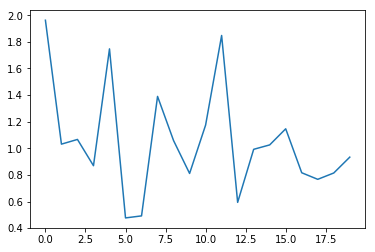

In [275]:
plt.plot(train_res_recon_error)


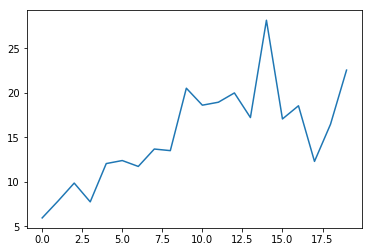

In [276]:
plt.plot(train_res_perplexity)


In [129]:
model.train()
train_res_recon_error = []
train_res_perplexity = []

for i in xrange(num_training_updates):
    (data, _) = next(iter(training_loader))
    data = data.to(device)
    optimizer.zero_grad()
    print("Data size")
    print(data.size())

    vq_loss, data_recon, perplexity = model(data)
    recon_error = F.mse_loss(data_recon, data) / std
    loss = recon_error + vq_loss
    loss.backward()

    optimizer.step()
    
    train_res_recon_error.append(recon_error.item())
    train_res_perplexity.append(perplexity.item())

    if (i+1) % 100 == 0:
        print('%d iterations' % (i+1))
        print('recon_error: %.3f' % np.mean(train_res_recon_error[-100:]))
        print('perplexity: %.3f' % np.mean(train_res_perplexity[-100:]))
        print()

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

100 iterations
recon_error: 2.378
perplexity: 1.860

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permut

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

200 iterations
recon_error: 2.323
perplexity: 1.975

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permut

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

300 iterations
recon_error: 2.279
perplexity: 3.318

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permut

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

400 iterations
recon_error: 2.269
perplexity: 3.724

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permut

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

500 iterations
recon_error: 2.195
perplexity: 5.546

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permut

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

600 iterations
recon_error: 2.287
perplexity: 6.147

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permut

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

700 iterations
recon_error: 2.216
perplexity: 8.136

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permut

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

800 iterations
recon_error: 2.220
perplexity: 9.426

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permut

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

900 iterations
recon_error: 2.116
perplexity: 9.522

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permut

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

1000 iterations
recon_error: 2.247
perplexity: 9.370

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

1100 iterations
recon_error: 2.155
perplexity: 9.302

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

1200 iterations
recon_error: 2.155
perplexity: 10.296

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

1300 iterations
recon_error: 2.233
perplexity: 9.752

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

1400 iterations
recon_error: 2.164
perplexity: 10.128

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

1500 iterations
recon_error: 2.062
perplexity: 9.961

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

1600 iterations
recon_error: 2.070
perplexity: 10.041

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

1700 iterations
recon_error: 2.204
perplexity: 9.935

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

1800 iterations
recon_error: 2.155
perplexity: 10.064

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

1900 iterations
recon_error: 2.250
perplexity: 9.991

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

2000 iterations
recon_error: 2.121
perplexity: 10.236

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

2100 iterations
recon_error: 2.045
perplexity: 10.229

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

2200 iterations
recon_error: 2.086
perplexity: 10.513

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

2300 iterations
recon_error: 2.133
perplexity: 10.516

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

2400 iterations
recon_error: 2.088
perplexity: 10.536

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

2500 iterations
recon_error: 2.175
perplexity: 10.959

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

2600 iterations
recon_error: 2.111
perplexity: 11.642

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

2700 iterations
recon_error: 2.066
perplexity: 11.297

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

2800 iterations
recon_error: 2.127
perplexity: 11.834

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

2900 iterations
recon_error: 1.962
perplexity: 11.739

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

3000 iterations
recon_error: 1.993
perplexity: 11.573

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

3100 iterations
recon_error: 2.084
perplexity: 11.709

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

3200 iterations
recon_error: 2.020
perplexity: 11.861

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

3300 iterations
recon_error: 2.033
perplexity: 11.411

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

3400 iterations
recon_error: 2.063
perplexity: 11.131

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

3500 iterations
recon_error: 2.041
perplexity: 11.874

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

3600 iterations
recon_error: 2.022
perplexity: 11.297

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

3700 iterations
recon_error: 2.008
perplexity: 11.678

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

3800 iterations
recon_error: 2.102
perplexity: 11.536

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

3900 iterations
recon_error: 1.959
perplexity: 11.431

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

4000 iterations
recon_error: 1.968
perplexity: 11.501

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

4100 iterations
recon_error: 2.007
perplexity: 11.718

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

4200 iterations
recon_error: 1.953
perplexity: 11.431

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

4300 iterations
recon_error: 1.944
perplexity: 10.818

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

4400 iterations
recon_error: 1.968
perplexity: 11.146

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

4500 iterations
recon_error: 2.004
perplexity: 10.838

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

4600 iterations
recon_error: 1.975
perplexity: 10.544

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

4700 iterations
recon_error: 1.915
perplexity: 10.938

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

4800 iterations
recon_error: 1.989
perplexity: 10.216

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

4900 iterations
recon_error: 1.988
perplexity: 10.813

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

5000 iterations
recon_error: 1.995
perplexity: 10.180

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

5100 iterations
recon_error: 2.046
perplexity: 10.857

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

5200 iterations
recon_error: 1.921
perplexity: 10.295

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

5300 iterations
recon_error: 1.986
perplexity: 10.056

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

5400 iterations
recon_error: 1.937
perplexity: 10.561

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

5500 iterations
recon_error: 1.872
perplexity: 10.012

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

5600 iterations
recon_error: 1.980
perplexity: 9.843

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

5700 iterations
recon_error: 1.903
perplexity: 10.040

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

5800 iterations
recon_error: 1.875
perplexity: 10.101

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

5900 iterations
recon_error: 1.860
perplexity: 9.789

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

6000 iterations
recon_error: 1.959
perplexity: 10.417

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

6100 iterations
recon_error: 1.945
perplexity: 10.166

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

6200 iterations
recon_error: 1.921
perplexity: 10.237

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

6300 iterations
recon_error: 1.806
perplexity: 9.925

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

6400 iterations
recon_error: 2.014
perplexity: 9.662

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

6500 iterations
recon_error: 1.937
perplexity: 10.106

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

6600 iterations
recon_error: 1.953
perplexity: 9.745

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

6700 iterations
recon_error: 1.929
perplexity: 9.785

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

6800 iterations
recon_error: 1.943
perplexity: 9.733

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

6900 iterations
recon_error: 1.919
perplexity: 9.877

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

7000 iterations
recon_error: 1.907
perplexity: 9.612

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

7100 iterations
recon_error: 1.895
perplexity: 9.709

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

7200 iterations
recon_error: 1.992
perplexity: 9.810

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

7300 iterations
recon_error: 1.885
perplexity: 9.104

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

7400 iterations
recon_error: 1.964
perplexity: 9.387

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

7500 iterations
recon_error: 1.891
perplexity: 9.273

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

7600 iterations
recon_error: 1.872
perplexity: 8.794

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

7700 iterations
recon_error: 1.968
perplexity: 9.200

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

7800 iterations
recon_error: 1.964
perplexity: 9.011

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

7900 iterations
recon_error: 1.912
perplexity: 8.955

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

8000 iterations
recon_error: 1.843
perplexity: 9.025

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

8100 iterations
recon_error: 1.967
perplexity: 8.965

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

8200 iterations
recon_error: 1.861
perplexity: 8.499

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

8300 iterations
recon_error: 1.881
perplexity: 8.829

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

8400 iterations
recon_error: 1.845
perplexity: 8.686

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

8500 iterations
recon_error: 1.792
perplexity: 8.662

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

8600 iterations
recon_error: 1.804
perplexity: 8.461

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

8700 iterations
recon_error: 1.806
perplexity: 8.170

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

8800 iterations
recon_error: 1.840
perplexity: 8.269

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

8900 iterations
recon_error: 1.831
perplexity: 8.327

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

9000 iterations
recon_error: 1.854
perplexity: 8.666

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

9100 iterations
recon_error: 1.824
perplexity: 8.361

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

9200 iterations
recon_error: 1.820
perplexity: 8.276

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

9300 iterations
recon_error: 1.877
perplexity: 8.271

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

9400 iterations
recon_error: 1.978
perplexity: 8.168

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

9500 iterations
recon_error: 1.825
perplexity: 8.090

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

9600 iterations
recon_error: 1.810
perplexity: 7.726

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

9700 iterations
recon_error: 1.867
perplexity: 8.008

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

9800 iterations
recon_error: 1.956
perplexity: 8.290

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

9900 iterations
recon_error: 1.818
perplexity: 8.297

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permu

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

10000 iterations
recon_error: 1.837
perplexity: 8.049

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

10100 iterations
recon_error: 2.012
perplexity: 8.020

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

10200 iterations
recon_error: 1.904
perplexity: 7.661

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

10300 iterations
recon_error: 1.858
perplexity: 7.869

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

10400 iterations
recon_error: 1.852
perplexity: 7.846

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

10500 iterations
recon_error: 1.868
perplexity: 7.846

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

10600 iterations
recon_error: 1.785
perplexity: 7.676

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

10700 iterations
recon_error: 1.841
perplexity: 7.762

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

10800 iterations
recon_error: 1.819
perplexity: 7.775

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

10900 iterations
recon_error: 1.769
perplexity: 7.776

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

11000 iterations
recon_error: 1.841
perplexity: 7.920

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

11100 iterations
recon_error: 1.813
perplexity: 7.884

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

11200 iterations
recon_error: 1.774
perplexity: 7.364

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

11300 iterations
recon_error: 1.827
perplexity: 7.867

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

11400 iterations
recon_error: 1.796
perplexity: 7.504

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

11500 iterations
recon_error: 1.794
perplexity: 7.940

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

11600 iterations
recon_error: 1.877
perplexity: 7.672

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

11700 iterations
recon_error: 1.900
perplexity: 7.384

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

11800 iterations
recon_error: 1.788
perplexity: 7.531

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

11900 iterations
recon_error: 1.869
perplexity: 7.431

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

12000 iterations
recon_error: 1.828
perplexity: 7.794

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

12100 iterations
recon_error: 1.853
perplexity: 7.811

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

12200 iterations
recon_error: 1.906
perplexity: 7.596

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

12300 iterations
recon_error: 1.831
perplexity: 7.459

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

12400 iterations
recon_error: 1.847
perplexity: 7.733

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

12500 iterations
recon_error: 1.803
perplexity: 7.439

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

12600 iterations
recon_error: 1.828
perplexity: 7.492

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

12700 iterations
recon_error: 1.770
perplexity: 7.329

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

12800 iterations
recon_error: 1.824
perplexity: 7.498

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

12900 iterations
recon_error: 1.784
perplexity: 7.564

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

13000 iterations
recon_error: 1.793
perplexity: 6.970

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

13100 iterations
recon_error: 1.863
perplexity: 7.220

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

13200 iterations
recon_error: 1.806
perplexity: 7.337

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

13300 iterations
recon_error: 1.796
perplexity: 7.308

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

13400 iterations
recon_error: 1.771
perplexity: 7.077

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

13500 iterations
recon_error: 1.856
perplexity: 7.271

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

13600 iterations
recon_error: 1.811
perplexity: 7.357

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

13700 iterations
recon_error: 1.822
perplexity: 7.117

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

13800 iterations
recon_error: 1.877
perplexity: 7.327

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

13900 iterations
recon_error: 1.831
perplexity: 7.359

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

14000 iterations
recon_error: 1.833
perplexity: 7.202

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

14100 iterations
recon_error: 1.748
perplexity: 6.887

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

14200 iterations
recon_error: 1.774
perplexity: 6.993

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

14300 iterations
recon_error: 1.849
perplexity: 7.261

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

14400 iterations
recon_error: 1.838
perplexity: 7.079

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

14500 iterations
recon_error: 1.757
perplexity: 7.019

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

14600 iterations
recon_error: 1.797
perplexity: 7.170

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

14700 iterations
recon_error: 1.871
perplexity: 7.170

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

14800 iterations
recon_error: 1.877
perplexity: 7.066

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

14900 iterations
recon_error: 1.721
perplexity: 6.751

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of perm

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

Data size
torch.Size([10, 1025, 100])
Model::forward
shape of inputs in Encoder.forward torch.Size([10, 1025, 100])
shape of x in Encoder.forward._conv_1 torch.Size([10, 768, 100])
shape of x in Encoder.forward.relu_2 torch.Size([10, 768, 100])
shape of x_conv_3 in Encoder.forward._conv_3 torch.Size([10, 768, 101])
shape of x_conv_4 in Encoder.forward._conv_4 torch.Size([10, 768, 101])
shape of x_conv_5 in Encoder.forward._conv_5 torch.Size([10, 768, 101])
shape of x in ResidualStack.forward torch.Size([10, 768, 101])
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 0 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of x in Residual.forward torch.Size([10, 768, 101])
Iteration 1 shape of x in ResidualStack.forward torch.Size([10, 768, 101]) 
shape of _residual_stack in Encoder.forward torch.Size([10, 768, 101])
shape of inputs in VectorQuantizer.forward torch.Size([10, 64, 101])
shape of permutated inputs in VectorQuantizer.forward torch.Size([10

15000 iterations
recon_error: 1.848
perplexity: 6.790



## Plot Loss 

In [204]:
len(train_res_recon_error)

20

In [203]:
train_res_recon_error_smooth = savgol_filter(train_res_recon_error, 201, 7)
train_res_perplexity_smooth = savgol_filter(train_res_perplexity, 201, 7)

ValueError: If mode is 'interp', window_length must be less than or equal to the size of x.

Text(0.5, 0, 'iteration')

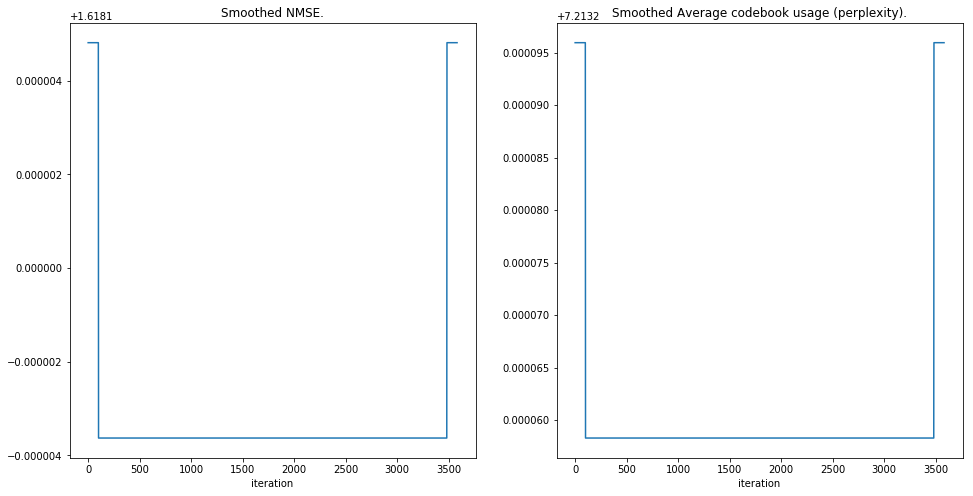

In [144]:
f = plt.figure(figsize=(16,8))
ax = f.add_subplot(1,2,1)
ax.plot(train_res_recon_error_smooth)
#ax.set_yscale('log')
ax.set_title('Smoothed NMSE.')
ax.set_xlabel('iteration')

ax = f.add_subplot(1,2,2)
ax.plot(train_res_perplexity_smooth)
ax.set_title('Smoothed Average codebook usage (perplexity).')
ax.set_xlabel('iteration')

## Reconstructions 

In [205]:
model.eval()

(valid_originals, _) = next(iter(validation_loader))
valid_originals = valid_originals.to(device)

vq_output_eval = model._pre_vq_conv(model._encoder(valid_originals))
_, valid_quantize, _, _ = model._vq_vae(vq_output_eval)
valid_reconstructions = model._decoder(valid_quantize, speaker_dic, speaker_id)

In [277]:
(data, _) = next(iter(training_loader))
data = data.to(device)

vq_loss, data_recon, perplexity = model(data)

In [278]:
data_recon[0]

tensor([[ 1.5226e+00,  5.8202e-01,  3.2414e-01,  ...,  2.5469e-01,
          2.6513e-01,  2.5658e-01],
        [ 1.5673e+00,  1.6267e+00,  1.3183e+00,  ...,  8.1716e-01,
          8.4120e-01,  8.0944e-01],
        [ 1.6830e+00,  2.2725e+00,  2.1309e+00,  ...,  1.2740e+00,
          1.2999e+00,  1.2471e+00],
        ...,
        [ 3.2560e-03,  1.1169e-03, -8.5087e-05,  ..., -9.7023e-04,
         -1.1636e-03, -1.0486e-03],
        [ 2.3879e-03,  5.8395e-04, -4.1513e-04,  ..., -3.3851e-04,
         -6.3789e-04, -5.6796e-04],
        [ 3.5068e-03,  1.0540e-03, -2.5994e-04,  ..., -1.3753e-03,
         -1.5770e-03, -1.4390e-03]], device='cuda:0', grad_fn=<SelectBackward>)

In [213]:
!mkdir '/home/ubuntu/voice_conversion/data/output/plots'

In [217]:
data_np = (data[].to(torch.device("cpu"))).detach().numpy();
data_griffin_lim = librosa.griffinlim(data_np)
#np.save(os.path.join('/home/ubuntu/voice_conversion/data/output', 'data.wav'), data_griffin_lim)

In [218]:
# convert torch tensor to numpy array
data_recon_np = (data_recon[1].to(torch.device("cpu"))).detach().numpy();
data_recon_griffin_lim = librosa.griffinlim(data_recon_np)
#np.save(os.path.join('/home/ubuntu/voice_conversion/data/output', 'data_recon3.wav'), data_recon_griffin_lim)

10

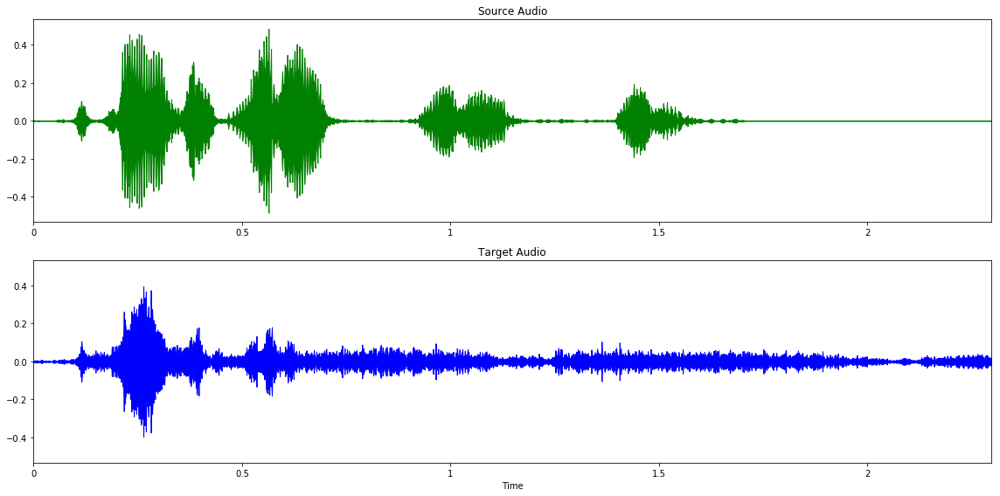

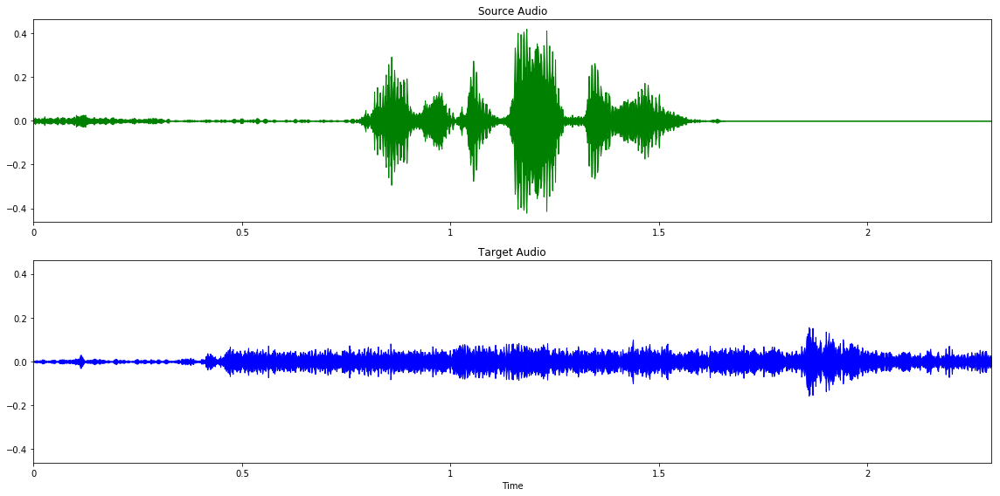

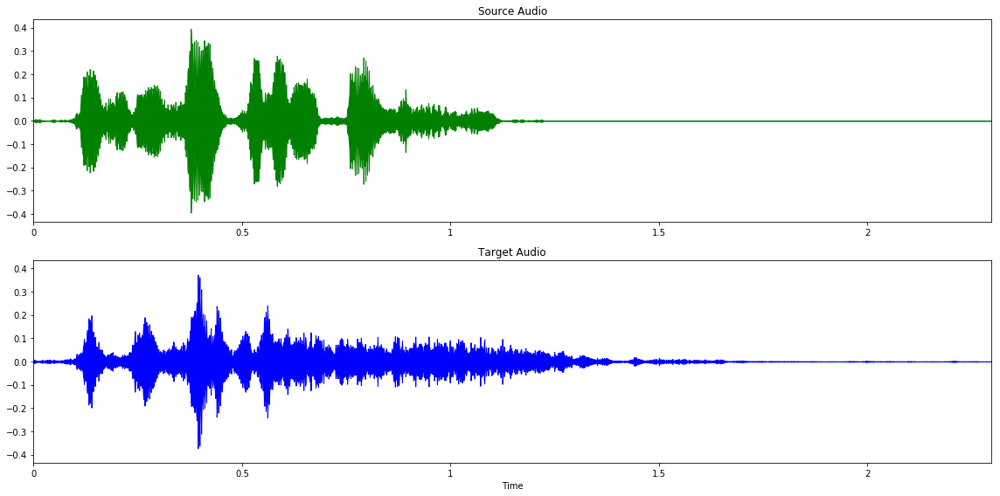

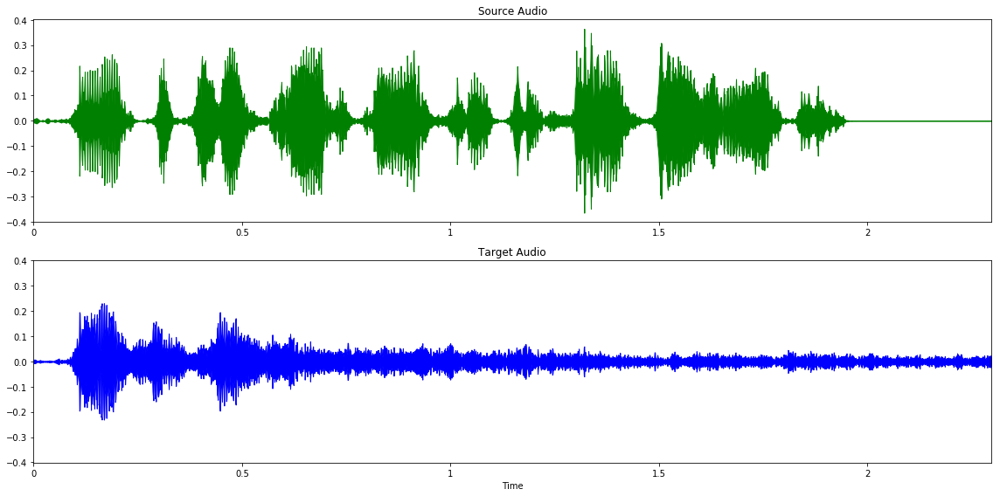

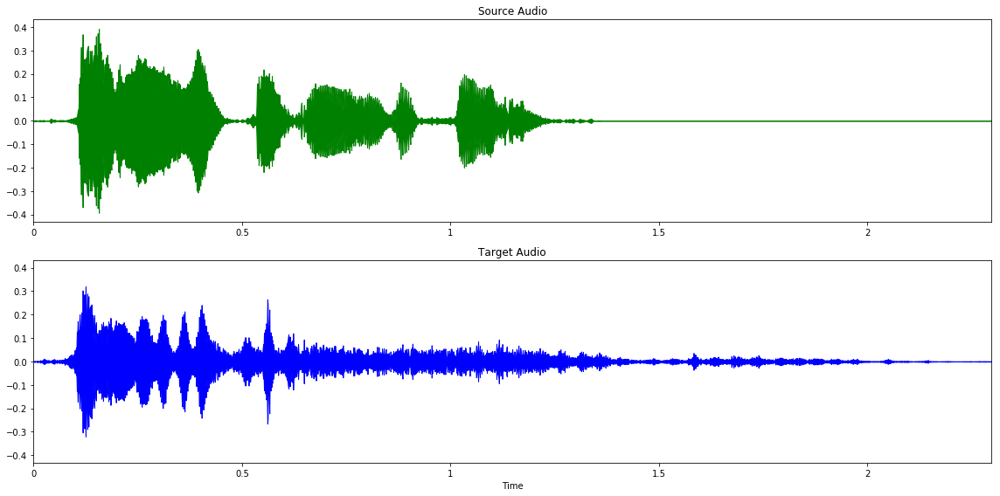

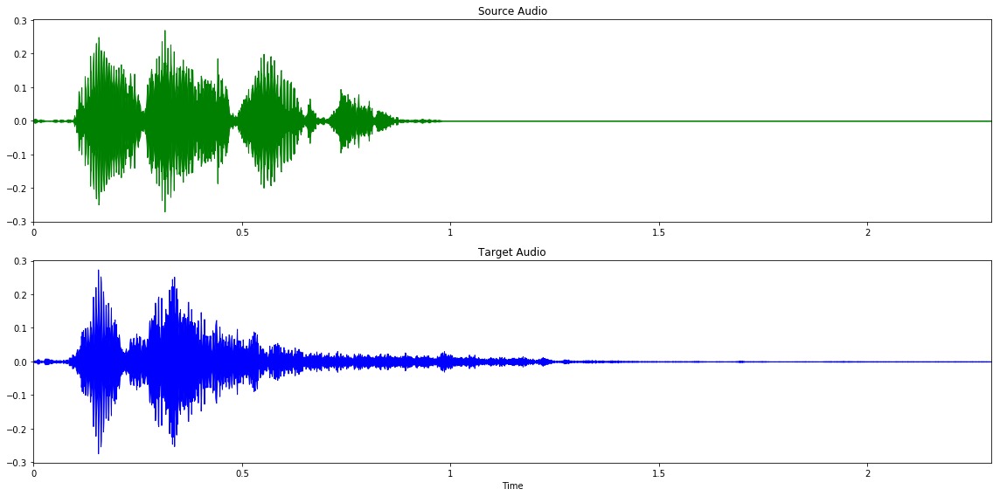

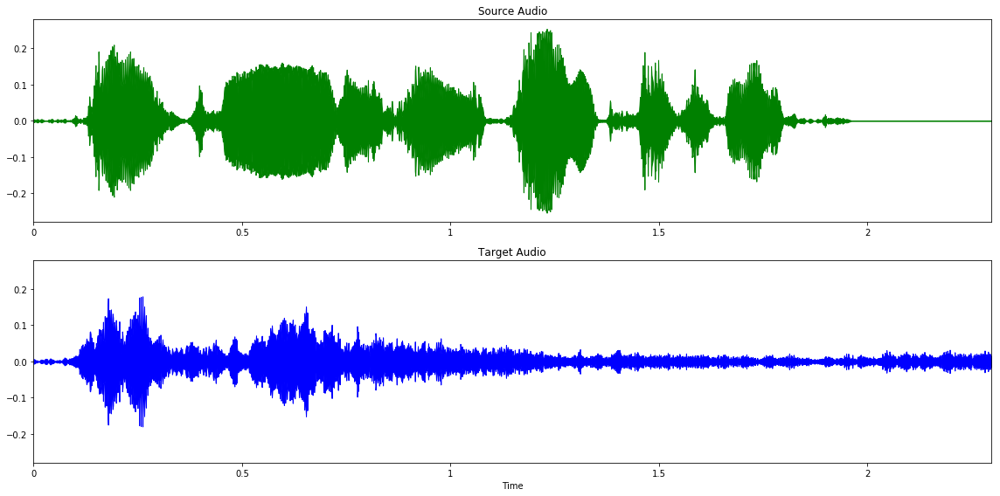

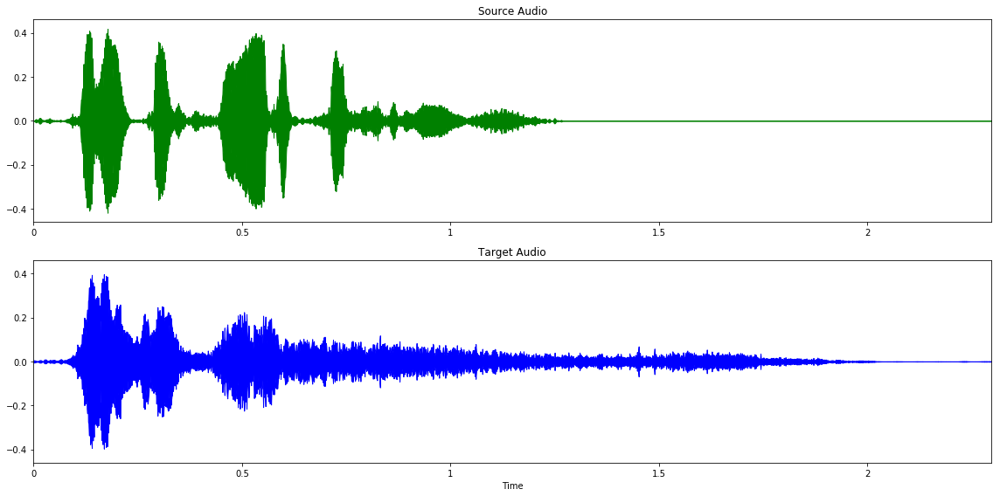

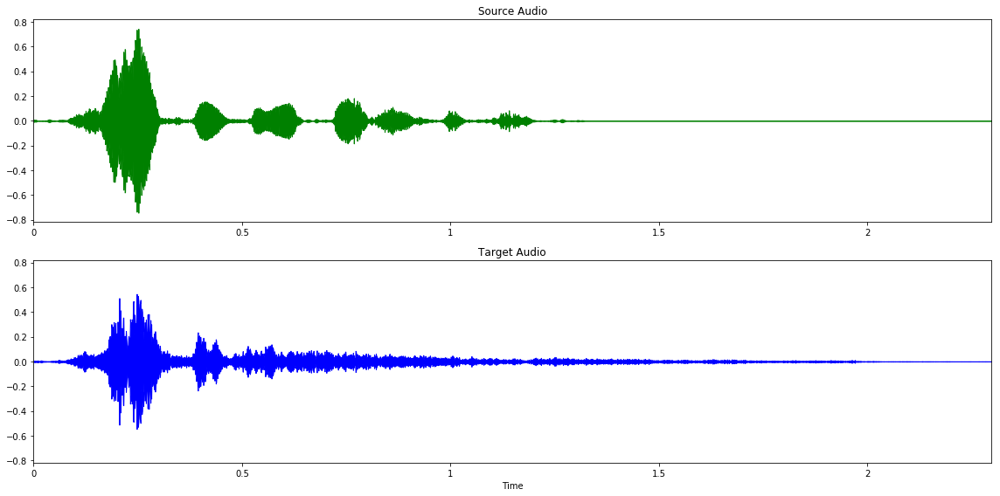

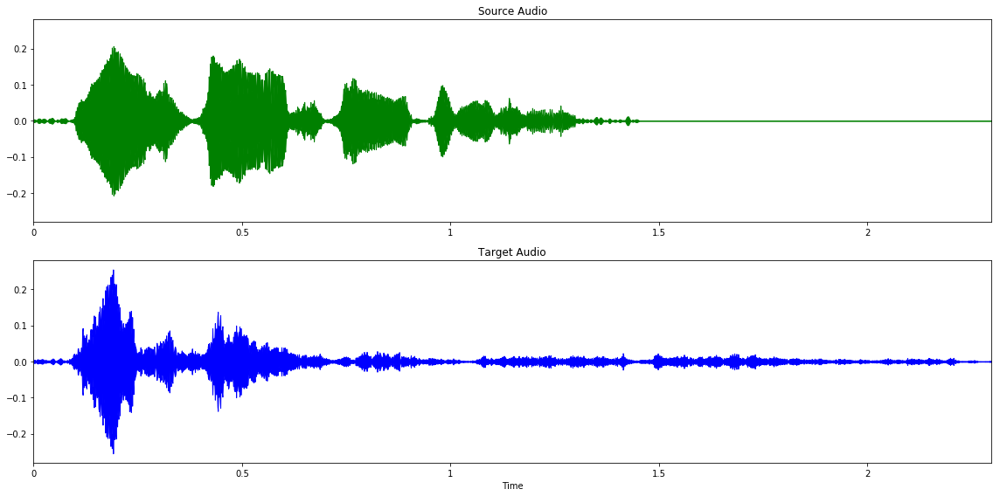

In [279]:
for i in range(len(data)):
    data_np = (data[i].to(torch.device("cpu"))).detach().numpy();
    data_griffin_lim = librosa.griffinlim(data_np)
    data_recon_np = (data_recon[i].to(torch.device("cpu"))).detach().numpy();
    data_recon_griffin_lim = librosa.griffinlim(data_recon_np)
    
    fig = plt.figure(figsize=(16, 8))
    ax = plt.subplot(2,1,1)
    output_path = '/home/ubuntu/voice_conversion/data/output/plots/300_raw_plot_' + str(i) + '.png'
    source_aud_path = '/home/ubuntu/voice_conversion/data/output/300_source_' + str(i) + '.wav'
    target_aud_path = '/home/ubuntu/voice_conversion/data/output/300_target_' + str(i) + '.wav'
    
    librosa.display.waveplot(data_griffin_lim, color = 'g')
    plt.title('Source Audio')
    plt.xlabel('')
    plt.subplot(2,1,2, sharex=ax, sharey=ax)
    plt.title('Target Audio')
    librosa.display.waveplot(data_recon_griffin_lim, color = 'b')
    plt.tight_layout()
    fig.savefig(output_path)
    
    librosa.output.write_wav(source_aud_path,data_griffin_lim, 16000)
    librosa.output.write_wav(target_aud_path,data_recon_griffin_lim, 16000)

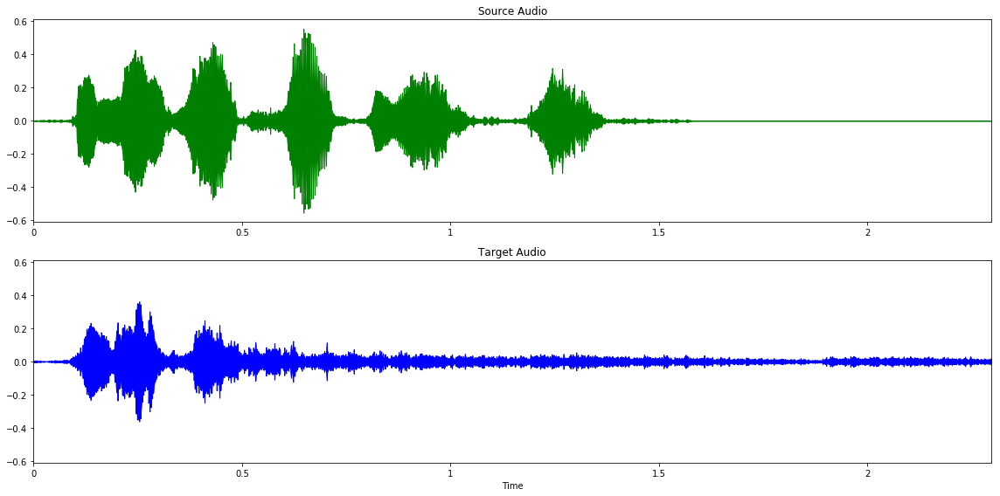

In [222]:
fig = plt.figure(figsize=(16, 8))
ax = plt.subplot(2,1,1)
output_path = '/home/ubuntu/voice_conversion/data/output/plots/raw_plot_' + str(i) + '.png'
librosa.display.waveplot(data_griffin_lim, color = 'g')
plt.title('Source Audio')
plt.xlabel('')
plt.subplot(2,1,2, sharex=ax, sharey=ax)
plt.title('Target Audio')
librosa.display.waveplot(data_recon_griffin_lim, color = 'b')
plt.tight_layout()
fig.savefig(output_path)

In [ ]:
for i in range(len(data)):
    data_np = (data[i].to(torch.device("cpu"))).detach().numpy();
    data_griffin_lim = librosa.griffinlim(data_np)
    data_recon_np = (data_recon[i].to(torch.device("cpu"))).detach().numpy();
    data_recon_griffin_lim = librosa.griffinlim(data_recon_np)
    
    fig = plt.figure(figsize=(16, 8))
    ax = plt.subplot(2,1,1)
    output_path = '/home/ubuntu/voice_conversion/data/output/plots/300_raw_plot_' + str(i) + '.png'
    source_aud_path = '/home/ubuntu/voice_conversion/data/output/300_source_' + str(i) + '.wav'
    target_aud_path = '/home/ubuntu/voice_conversion/data/output/300_target_' + str(i) + '.wav'
    
    librosa.display.waveplot(data_griffin_lim, color = 'g')
    plt.title('Source Audio')
    plt.xlabel('')
    plt.subplot(2,1,2, sharex=ax, sharey=ax)
    plt.title('Target Audio')
    librosa.display.waveplot(data_recon_griffin_lim, color = 'b')
    plt.tight_layout()
    fig.savefig(output_path)
    
    librosa.output.write_wav(source_aud_path,data_griffin_lim, 16000)
    librosa.output.write_wav(target_aud_path,data_recon_griffin_lim, 16000)

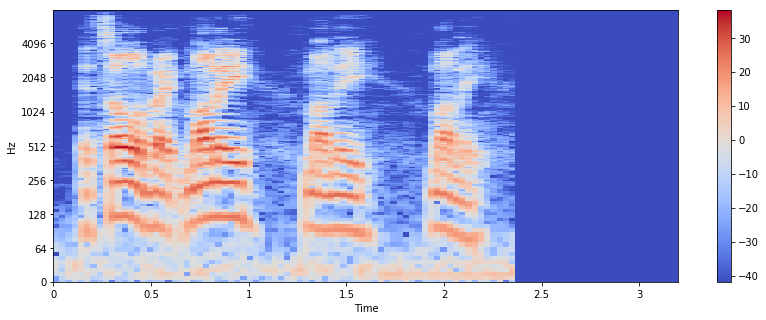

In [289]:
data_np = (data[0].to(torch.device("cpu"))).detach().numpy();
data_np = librosa.amplitude_to_db(abs(data_np))
plt.figure(figsize=(14, 5))
librosa.display.specshow(data_np, sr=16000, x_axis='time', y_axis='log')
plt.colorbar()

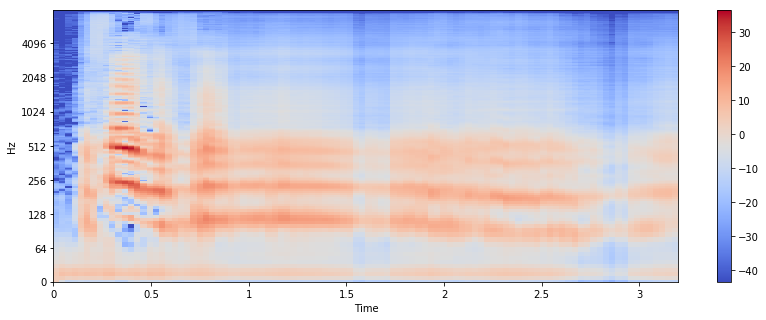

In [290]:
data_np = (data_recon[0].to(torch.device("cpu"))).detach().numpy();
data_np = librosa.amplitude_to_db(abs(data_np))
plt.figure(figsize=(14, 5))
librosa.display.specshow(data_np, sr=16000, x_axis='time', y_axis='log')
plt.colorbar()

In [ ]:
## View Embeddings 

In [230]:
proj = umap.UMAP(n_neighbors=3,
                 min_dist=0.1,
                 metric='cosine').fit_transform(model._vq_vae._embedding.weight.data.cpu())

AttributeError: module 'umap' has no attribute 'UMAP'

In [ ]:
plt.scatter(proj[:,0], proj[:,1], alpha=0.3)